## 0. Introduction

The aim of this lab is to get familiar with **Mixture of Gaussians** model.


1.   This lab is the course-work activity **Assignment 2: Unsupervised Learning(20%)**
2. The Assignment is due on **Friday , 1st December, 11:59pm**
2.   A report answering the <font color = 'red'>**questions in</font><font color = "maroon"> red**</font> should be submitted on QMplus along with the completed Notebook.
3. The report should be a separate file in **pdf format** (so **NOT** *doc, docx, notebook* etc.), well identified with your name, student number, assignment number (for instance, Assignment 1), module code.
4. Make sure that **any figures or code** you comment on, are **included in the report**.
5. No other means of submission other than the appropriate QM+ link is acceptable at any time (so NO email attachments, etc.)
6. **PLAGIARISM** <ins>is an irreversible non-negotiable failure in the course</ins> (if in doubt of what constitutes plagiarism, ask!).

In [1]:
import os
import numpy as np
import scipy
from sklearn.preprocessing import normalize
import matplotlib.pyplot as plt
from IPython import display
%matplotlib inline

For this lab, we will use the Peterson and Barney’s dataset of vowel formant frequencies. (For more info, look at Classification of Peterson & Barney’s vowels using Weka. - a copy of this article is on QMplus)

More specifically, Peterson and Barney measured the fundamental frequency $F0$ and the first three formant frequencies ($F1-F3$) of sustained English Vowels, using samples from various speakers.

Upload the .npy file and load it using the code block below.

In [2]:
# from google.colab import files
# files.upload()
data_npy_file = 'PB_data.npy'

# Loading data from .npy file
data = np.load(data_npy_file, allow_pickle=True)
data = np.ndarray.tolist(data)

In [3]:
data

{'f3': array([2850, 2790, 2640, ..., 3380, 2160, 2200], dtype=uint16),
 'f2': array([2280, 2400, 2030, ..., 1140, 1850, 1830], dtype=uint16),
 'f1': array([240, 280, 390, ..., 500, 740, 660], dtype=uint16),
 'f0': array([160, 186, 203, ..., 334, 308, 328], dtype=uint16),
 'phoneme_id': array([ 1,  1,  2, ...,  9, 10, 10], dtype=uint8)}

The dataset contains 4 vectors ($F0-F3$), containing the fundamental frequencies ($F0$, $F1$, $F2$ and $F3$) for each phoneme and another vector “phoneme\_id” containing a number representing the id of the phoneme.

In the exercises that follow, we will use only the dataset associated with formants $F1$ and $F2$.

**Note**: Phonemes and Frequencies are two different things; phoneme_id is the ground truth class of each row while frequencies represent features of each data point. Please review the papers provided with the lab materials for more details.

In [4]:

# Array that contains the phoneme ID (1-10) of each sample
phoneme_id = data['phoneme_id']

# frequencies f1 and f2
f1 = data['f1']
f2 = data['f2']

print(phoneme_id.shape, f1.shape, f2.shape)


(1520,) (1520,) (1520,)


### <font color="maroon"> Q1. Produce a plot of $F1$ against $F2$. (You should be able to spot some clusters already in this scatter plot.). Comment on the figure and the visible clusters [2 marks]</font>

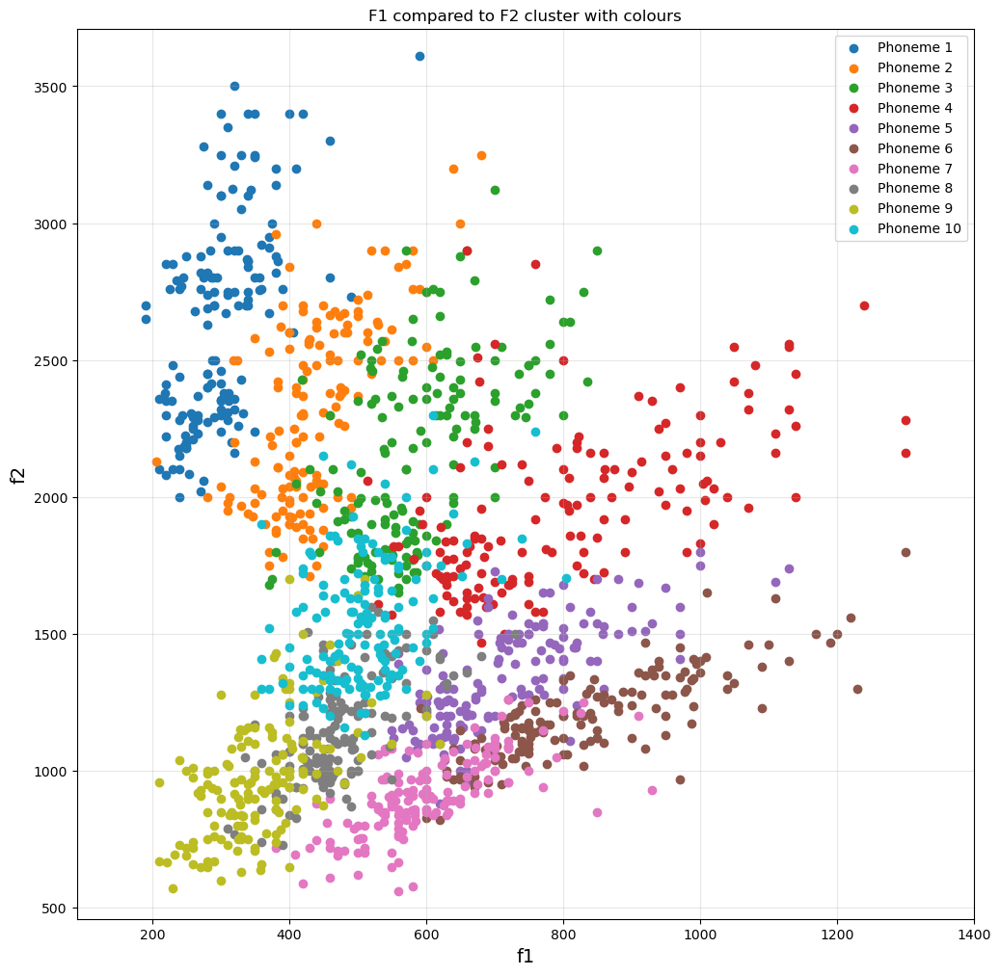

In [6]:
num_phonemes = len(np.unique(phoneme_id))
# colors = plt.cm.get_cmap('viridis', num_phonemes)
# print(f"colours: {colors.colors}")

# Create a scatter plot with different colors for each phoneme
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot()
ax.set_title("F1 compared to F2 cluster with colours")

ax.set_xlabel("f1", fontsize=14)
ax.set_ylabel("f2", fontsize=14)

for phoneme_category in range(1, num_phonemes + 1):
    mask = phoneme_id == phoneme_category
    ax.scatter(f1[mask], f2[mask], label=f'Phoneme {phoneme_category}') # , color=colors(phoneme_category - 1))

ax.grid(alpha=0.3)
ax.set_xlim(f1.min() - 100, f1.max() + 100)
ax.set_ylim(f2.min() - 100, f2.max() + 100)

# Add legend
ax.legend()

plt.show()

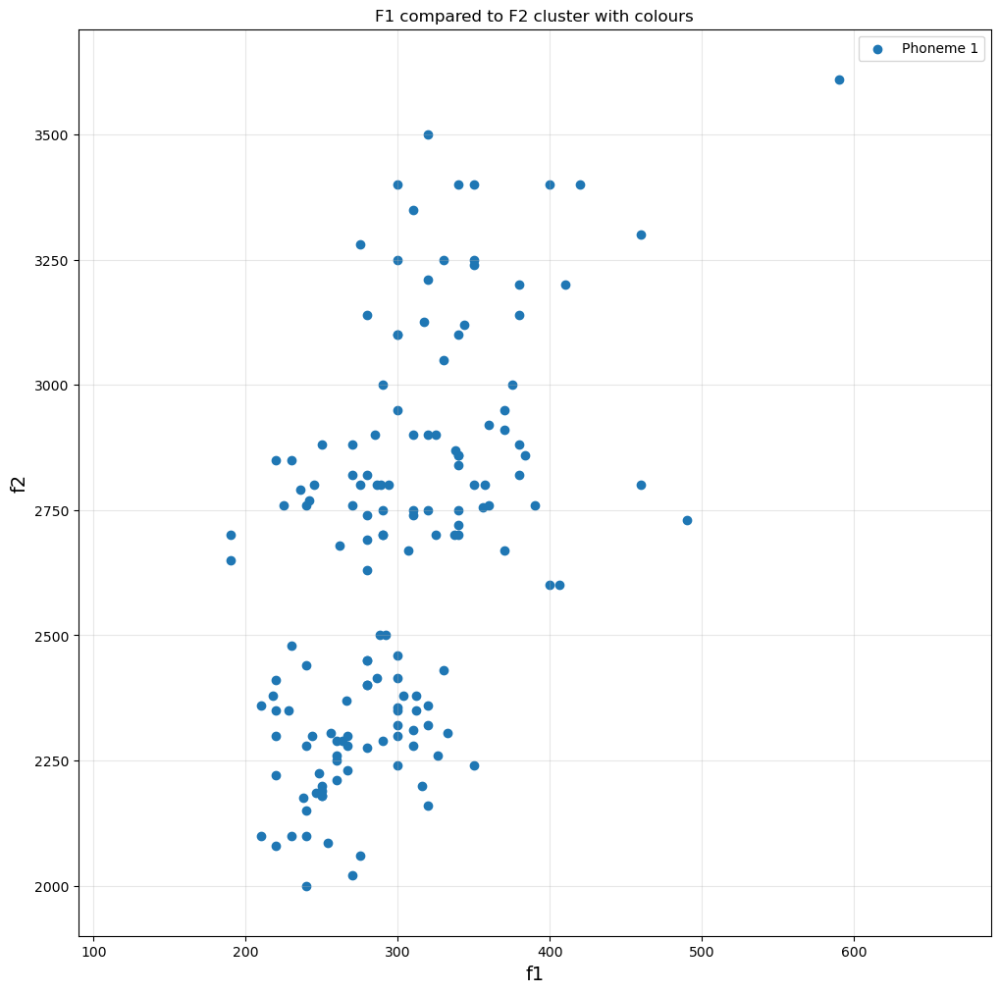

In [7]:
### your code here

num_phonemes = len(np.unique(phoneme_id))
# colors = plt.cm.get_cmap('viridis', num_phonemes)
# print(f"colours: {colors.colors}")

# Create a scatter plot with different colors for each phoneme
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot()
ax.set_title("F1 compared to F2 cluster with colours")

ax.set_xlabel("f1", fontsize=14)
ax.set_ylabel("f2", fontsize=14)

for phoneme_category in range(1, num_phonemes + 1):
    if phoneme_category == 1:
        mask = phoneme_id == phoneme_category
        ax.scatter(f1[mask], f2[mask], label=f'Phoneme {phoneme_category}') # , color=colors(phoneme_category - 1))

ax.grid(alpha=0.3)
ax.set_xlim(f1[mask].min() - 100, f1[mask].max() + 100)
ax.set_ylim(f2[mask].min() - 100, f2[mask].max() + 100)

# Add legend
ax.legend()

plt.show()

(1520,) (1520,)
[240 280 390 ... 500 740 660] [2280 2400 2030 ... 1140 1850 1830]
(1, 1520) (1, 1520)
[[0.01029152 0.01200678 0.01672373 ... 0.02144068 0.0317322  0.02830169]] [[0.03351831 0.03528243 0.02984306 ... 0.01675915 0.02719687 0.02690285]]


[]

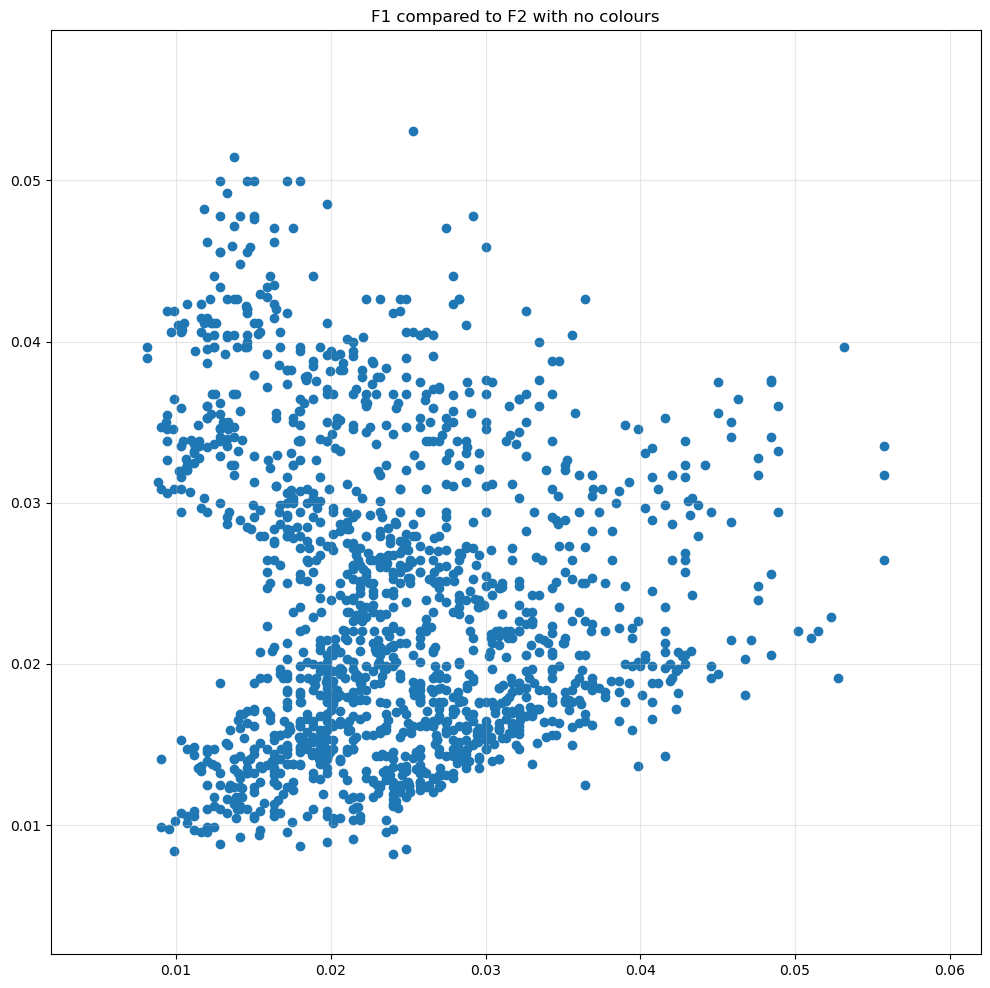

In [8]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot()
ax.set_title("F1 compared to F2 with no colours")

print(f1.shape, f2.shape)
print(f1, f2)
f1_norm = normalize(f1.reshape(1, -1))
f2_norm = normalize(f2.reshape(1, -1))
print(f1_norm.shape, f2_norm.shape)
print(f1_norm, f2_norm)
ax.scatter(f1_norm, f2_norm)
ax.grid(alpha=0.3)
ax.set_xlim(f1_norm.min()-0.00625, f1_norm.max()+0.00625)
ax.set_ylim(f2_norm.min()-0.00625, f2_norm.max()+0.00625)
plt.plot()

# 1. MoG Using the EM algorithm

Recall the following definition of a Mixture of Gaussians. Assuming our observed random vector is $\mathbf{x}\in\mathbb{R}^D$, a MoG models $p(\mathbf{x})$ as a sum of $K$-many weighted Gaussians. More specifically:


\begin{equation}
 p(\mathbf{x}) = \sum_{k=1}^K \frac{p(c_{k})}{(2\pi)^{D/2} \mathrm{det}\left(\boldsymbol\Sigma_k\right)^{1/2}}
 % \exp(-\frac{1}{2}(x-\mu)^T \sum_{k}^{-1}(x-\mu))
 \exp\left(-\frac{1}{2}(\mathbf{x}-\boldsymbol\mu_k)^\top {\boldsymbol\Sigma_k}^{-1}(\mathbf{x}-\boldsymbol\mu_k)\right),
\end{equation}
where:
* $\boldsymbol\mu_k\in\mathbb{R}^{D}$
* $\boldsymbol\Sigma_{k}\in\mathbb{R}^{D\times D}$
* $p(c_{k})=\pi_k\in\mathbb{R}$

denote the $k$-th gaussian component's **mean vector**, **covariance matrix**, and **mixture coefficients** respectively. The $K$-many gaussian components' model parameters are referred to collectively as $\theta = \{\boldsymbol\mu_k,\boldsymbol\Sigma_{k},\pi_k\}_{k=1}^K$.

## EM Algorithm
For the E step we softly assign each datum to the closest centroid (using the current iteration's fixed model parameters) as in the K means example.

For the M step we update the model parameters $\theta$ to maximize the weighted log-likelihood.
At a high level, for each centroid k we:
* Update the mean vectors
* Update the covariance matrices (We will fit Gaussians with diagonal covariance matrices)
* Set the mixture coefficients as the mean probability of a sample being generated by the k-th gaussian component

Read the code below and understand what it is calculating

In [9]:
def get_predictions(mu, s, p, X):
    """
    :param mu			: means of GMM components
    :param s			: covariances of GMM components
    :param p 			: weights of GMM components
    :param X			: 2D array of our dataset
    """
    # get number of GMM components / clusters
    k = s.shape[0]
    # get number of data samples
    N = X.shape[0]
    # get dimensionality of our dataset
    D = X.shape[1]
    
    Z = np.zeros((N, k))
    for i in range(k):  # for each column.
        mu_i = mu[i, :]
        mu_i = np.expand_dims(mu_i, axis=1)  # [[m1], [m2],[m3]]  3,1 from 3,
        mu_i_repeated = np.repeat(mu_i, N, axis=1)  
        # within each element in axis 1, repeat it by N times ... [[m1, m1, m1, ..], [m2, m2, m2,....], [m3,m3,m3,....] ]  # 3,N
        X_minus_mu = X - mu_i_repeated.transpose() # X is N, d  - N, d , each coord is minus by the mean. 
        print(s[i], "s [i]")
        inverse_s = scipy.linalg.pinv(s[i])
        #print("inverse _s: ", inverse_s)
        inverse_s = np.squeeze(inverse_s)
        s_i_det = scipy.linalg.det(s[i])
        x_s_x = np.matmul(X_minus_mu, inverse_s)*X_minus_mu
        Z[:, i] = p[i]*(1/np.power(((2*np.pi)**D) * np.abs(s_i_det), 0.5)) * np.exp(-0.5*np.sum(x_s_x, axis=1))
    return Z


### Helper functions

In [10]:
def plot_gaussians(ax, s, mu, X, title_string):
    """
        :param X            : 2D array of our dataset
        :param y            : 1D array of the groundtruth labels of the dataset
        :param ax          : existing subplot, to draw on it
    """
    ax.clear()
    if X.shape[1] == 2:
        # set label of horizontal axis
        ax.set_xlabel('f1')
        # set label of vertical axis
        ax.set_ylabel('f2')
        # scatter the points, with red color
        ax.scatter(X[:,0], X[:,1], c='black', marker='.', label=title_string)

    k = s.shape[0]
    color_list = ['r', 'g', 'b', 'c', 'm', 'y']
    N_sides = 11

    # Iterate over all gaussians
    for k_cnt in range(k):

        # pick the covariance matrix and mean values of each gaussian
        s_k = s[k_cnt]
        mu_k = mu[k_cnt]

        if s_k.shape[0]==2:
            # dataset with 2 features
            side_range = np.arange(0, N_sides, 1)
            theta = side_range/(N_sides-1)*2*np.pi
            matrix = np.array([np.cos(theta), np.sin(theta)])
            mu_k = np.expand_dims(mu_k, axis=1)
            mu_repeated = np.repeat(mu_k, N_sides, axis=1)
            epoints = np.matmul(scipy.linalg.sqrtm(s_k), matrix) + mu_repeated
            plt.plot(epoints[0,:], epoints[1,:], color=color_list[k_cnt], linewidth=2)
            plt.scatter(mu_k[0], mu_k[1], color=color_list[k_cnt], marker='o', linewidth=2)
        elif s_k.shape[0]==3:
            # dataset with 3 features
            side_range = np.arange(0, N_sides, 1)
            theta = side_range/(N_sides-1)*np.pi
            phi = side_range/(N_sides-1)*2*np.pi
            sin_theta = np.expand_dims(np.sin(theta), axis=1)
            cos_theta = np.expand_dims(np.cos(theta), axis=1)
            sin_phi = np.expand_dims(np.sin(phi), axis=1)
            cos_phi = np.expand_dims(np.cos(phi), axis=1)
            sx = np.matmul(sin_theta, cos_phi.transpose())
            sy = np.matmul(sin_theta, sin_phi.transpose())
            sz = np.matmul(cos_theta, np.ones((1, N_sides)))
            svect = np.array([sx.reshape((N_sides*N_sides)), sy.reshape((N_sides*N_sides)), sz.reshape((N_sides*N_sides))])

            mu_k = np.expand_dims(mu_k, axis=1)
            mu_repeated = np.repeat(mu_k, N_sides*N_sides, axis=1)
            epoints = np.matmul(scipy.linalg.sqrtm(s_k), svect) + mu_repeated

            ex = epoints[0]
            ey = epoints[1]
            ez = epoints[2]

            ax.plot3D(epoints[0,:], epoints[1,:], epoints[2,:], color=color_list[k_cnt])
            ax.plot3D(ex, ey, ez, color=color_list[k_cnt])
        else:
            print('Each dataset sample should have either 2 or 3 features. Not plotting this one.')
    ax.legend()
    display.clear_output(wait=True)
    display.display(plt.gcf())

def plot_data_3D(X, title_string, ax):
    """
        :param X            : 2D array of our dataset
        :param y            : 1D array of the groundtruth labels of the dataset
        :param ax          : existing subplot, to draw on it
    """
    # clear subplot from previous (if any) drawn stuff
    ax.clear()
    # set label of x axis
    ax.set_xlabel('f1')
    # set label of y axis
    ax.set_ylabel('f2')
    # set label of z axis
    ax.set_zlabel('f1 + f2')
    # scatter the points, with red color
    ax.scatter3D(X[:,0], X[:,1], X[:,2], c='black', marker='.', label=title_string)
    # add legend to the subplot
    ax.legend()


def save_model(mu, s, p, p_id, k):
  print("Saving model")
  GMM_parameters = {}
  GMM_parameters['mu'] = mu
  GMM_parameters['s'] = s
  GMM_parameters['p'] = p
  if not os.path.isdir('data/'):
    os.mkdir('data/')
  npy_filename = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(p_id, k)
  np.save(npy_filename, GMM_parameters)

## Train MoG

Read the following blocks of code and understand what it does.

In [11]:
k = 3
# id of the phoneme that will be used (e.g. 1, or 2)
p_id = 1
X_full = np.zeros((len(f1), 2))
X_full[:,0] = f1.copy()
X_full[:,1] = f2.copy()
X_full = X_full.astype(np.float32)

X = X_full[phoneme_id==p_id,:]

In [12]:
def estimate_guass(k, p_id):
    X_full = np.zeros((len(f1), 2))
    X_full[:,0] = f1.copy()
    X_full[:,1] = f2.copy()
    X_full = X_full.astype(np.float32)
    
    X = X_full[phoneme_id==p_id,:]
    # get number of samples
    N = X.shape[0]
    # get dimensionality of our dataset
    D = X.shape[1]
    # common practice : GMM weights initially set as 1/k
    p = np.ones((k))/k
    # GMM means are picked randomly from data samples
    random_indices = np.floor(N*np.random.rand((k)))
    random_indices = random_indices.astype(int)
    mu = X[random_indices,:] # shape kxD
    # covariance matrices
    s = np.zeros((k,D,D)) # shape kxDxD
    # number of iterations for the EM algorithm
    n_iter = 100
    
    # initialize covariances
    for i in range(k):
        cov_matrix = np.cov(X.transpose())
        # initially set to fraction of data covariance
        s[i,:,:] = cov_matrix/k
    
    # Initialize array Z that will get the predictions of each Gaussian on each sample
    Z = np.zeros((N,k)) # shape Nxk
    
    ###############################
    # run Expectation Maximization algorithm for n_iter iterations
    n_iter = 100
    for t in range(n_iter):
        print('Iteration {:03}/{:03}'.format(t+1, n_iter))
    
        # Do the E-step
        Z = get_predictions(mu, s, p, X)
        Z = normalize(Z, axis=1, norm='l1')
    
        # Do the M-step:
        for i in range(k):
            mu[i,:] = np.matmul(X.transpose(),Z[:,i]) / np.sum(Z[:,i])
    
            ###################################################
            # We will fit Gaussians with diagonal covariance matrices:
            mu_i = mu[i,:]
            mu_i = np.expand_dims(mu_i, axis=1)
            mu_i_repeated = np.repeat(mu_i, N, axis=1)
            coef_1 = (X.transpose() - mu_i_repeated)**2
            coef_2 = Z[:,i]/np.sum(Z[:,i])
            coef_2 = np.expand_dims(coef_2, axis=1)
            res_1 = np.squeeze( np.matmul(coef_1, coef_2) )
            s[i,:,:] = np.diag(res_1)
    
            p[i] = np.mean(Z[:,i])
    
        fig, ax1 = plt.subplots()
        plot_gaussians(ax1, 2*s, mu, X, 'Phoneme {}'.format(p_id))
    print('\nFinished.\n')
    print(mu, s)
    save_model(mu, s, p, p_id, k)

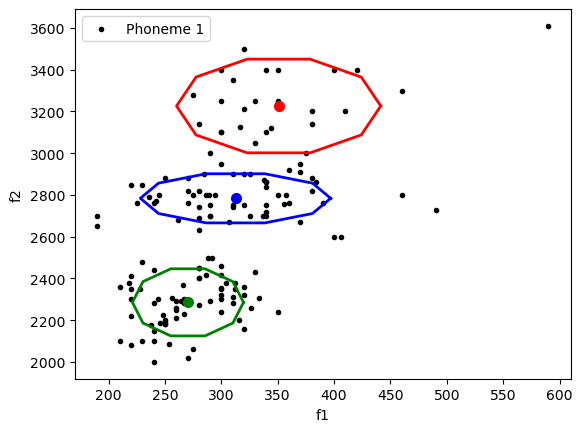


Finished.

[[ 350.8446  3226.3394 ]
 [ 270.3952  2285.4653 ]
 [ 312.59125 2783.898  ]] [[[ 4102.8751181      0.        ]
  [    0.         27829.55807827]]

 [[ 1213.73843438     0.        ]
  [    0.         14278.42048604]]

 [[ 3562.59745624     0.        ]
  [    0.          7657.84757066]]]
Saving model


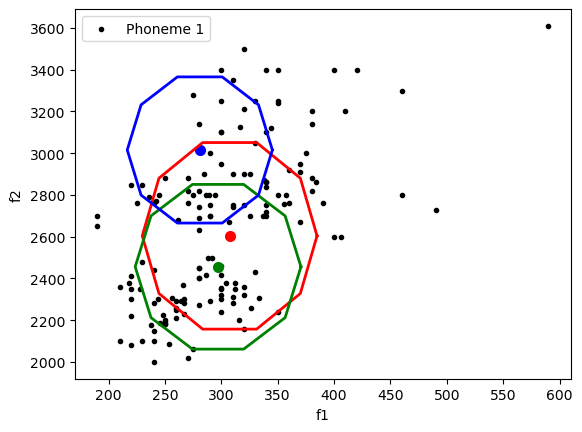

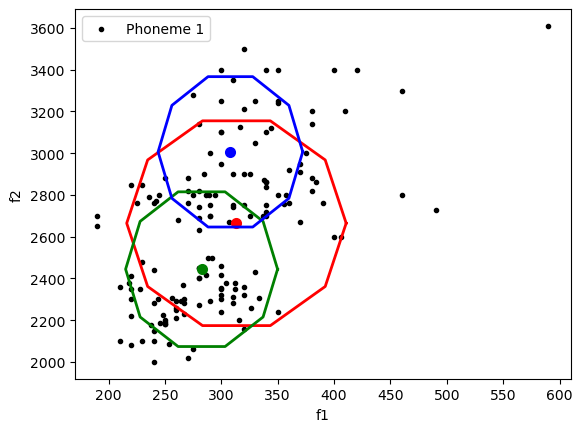

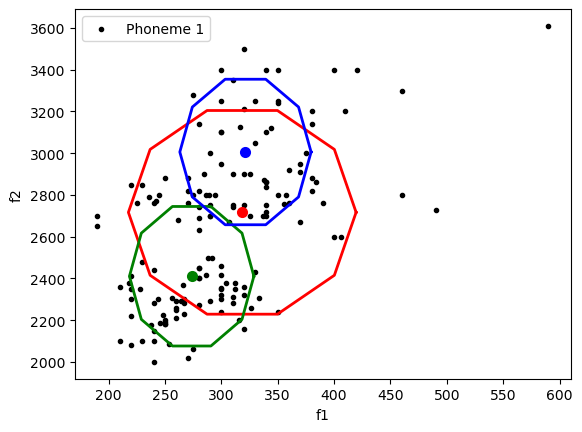

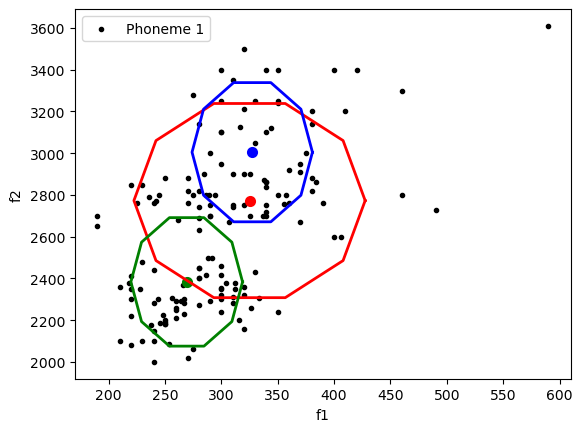

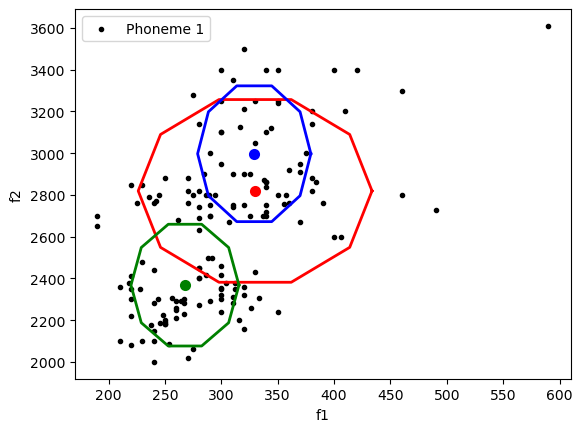

...

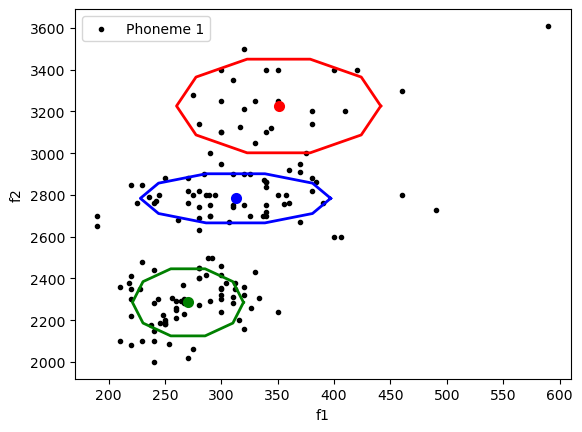

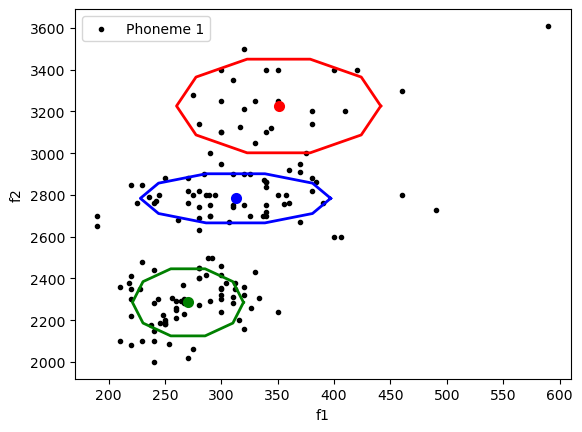

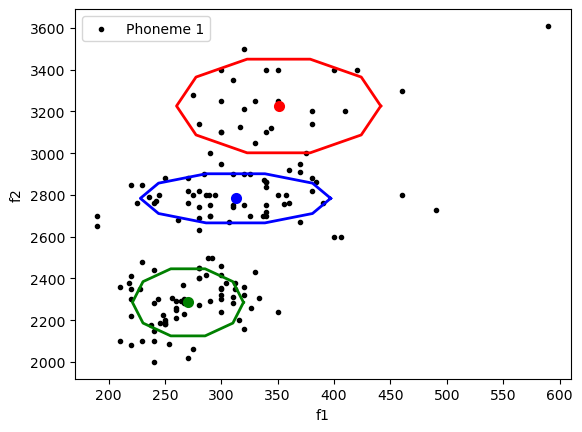

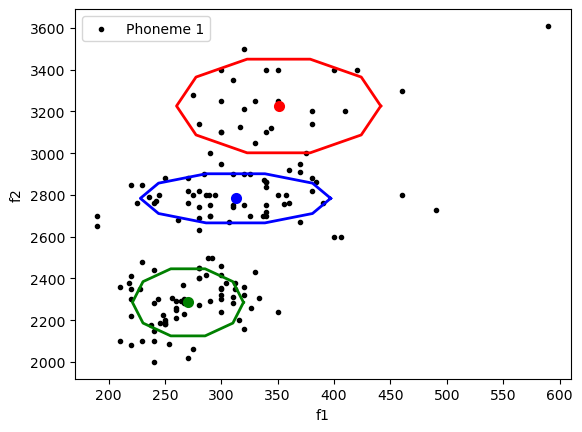

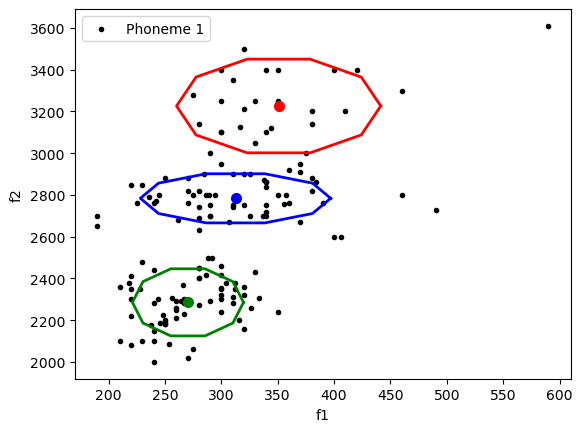

In [13]:
k = 3
p_id = 1
_=estimate_guass(k, p_id)

### <font color="maroon"> Q2. Run the code multiple times for $K=3$, what do you observe? Use figures and the printed MoG parameters to support your arguments [2 mark] </font>
###  Q3. Repeat the training for phoneme_id = 2  and save the parameters [1 mark]
### Q4. Repeat training for $K=6$ for phoneme_id =1 and phoneme_id=2 and save the model parameters [1 mark]

Save your MoG model: this should comprise the variables mu, s and p. Include the all the saved model parameters in the submission .zip folder.

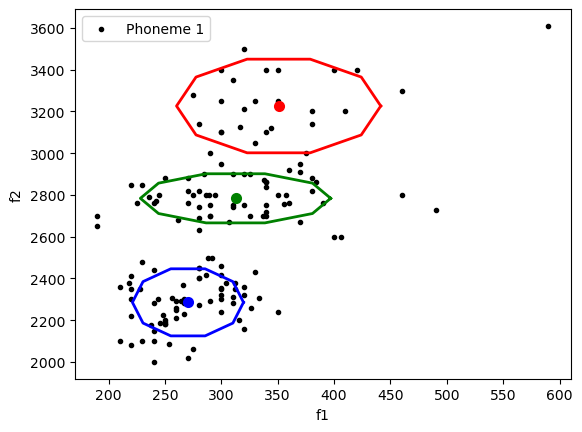


Finished.

[[ 350.8446  3226.3394 ]
 [ 312.59125 2783.898  ]
 [ 270.3952  2285.4653 ]] [[[ 4102.87537479     0.        ]
  [    0.         27829.54222673]]

 [[ 3562.59743767     0.        ]
  [    0.          7657.84897123]]

 [[ 1213.73843494     0.        ]
  [    0.         14278.42029969]]]
Saving model


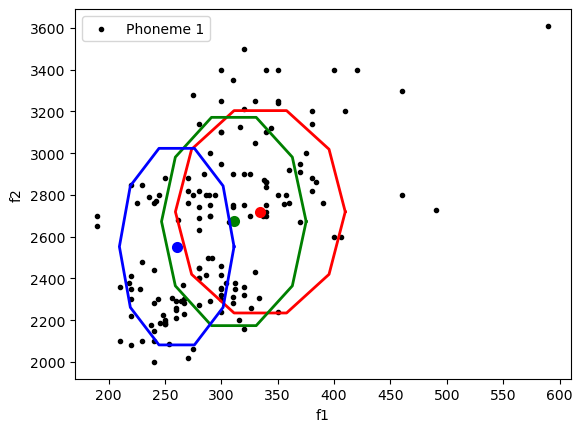

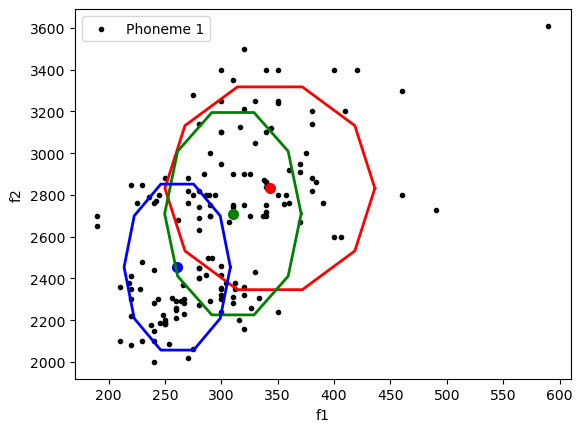

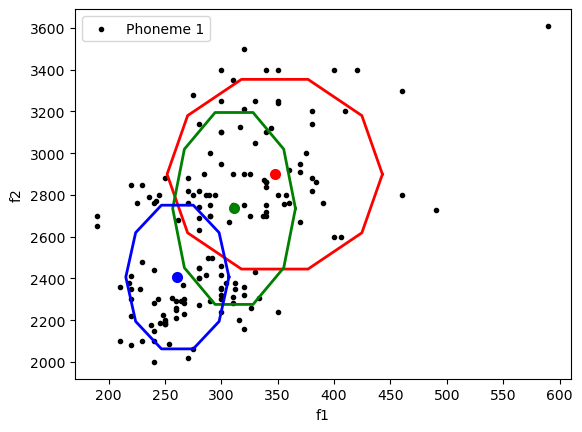

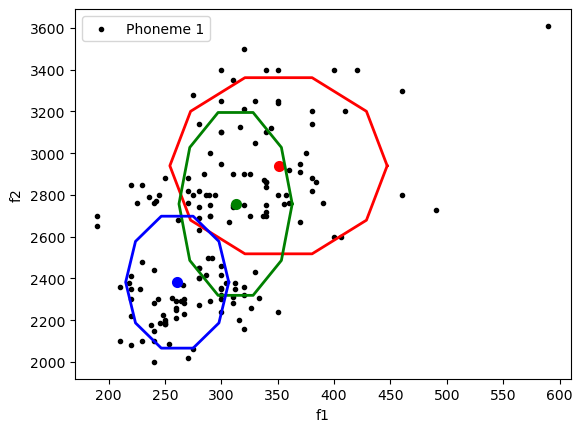

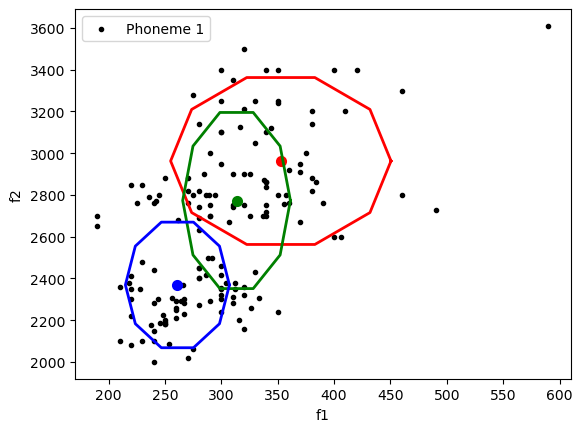

...

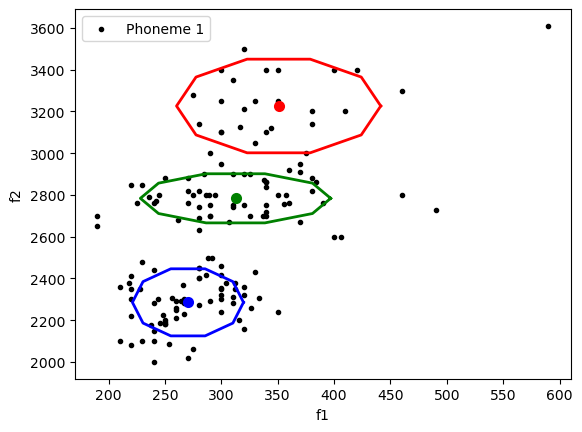

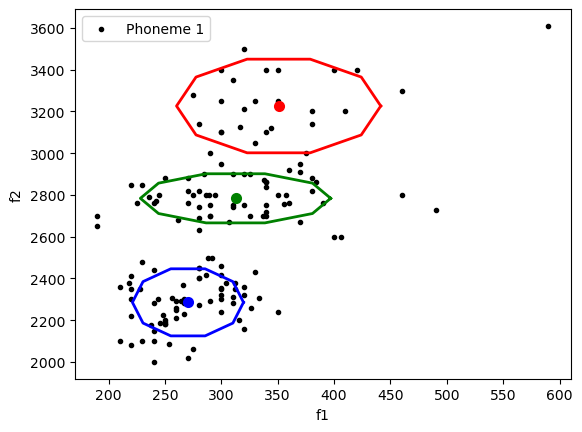

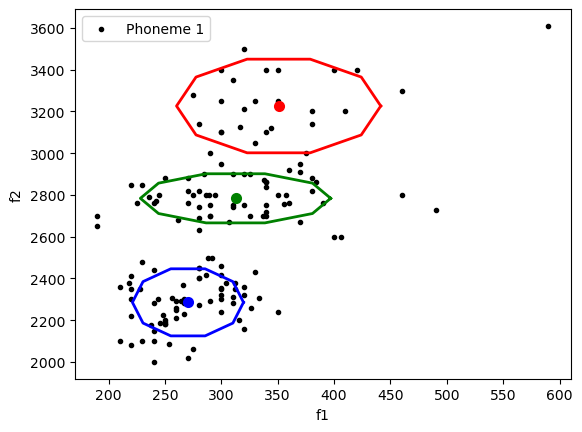

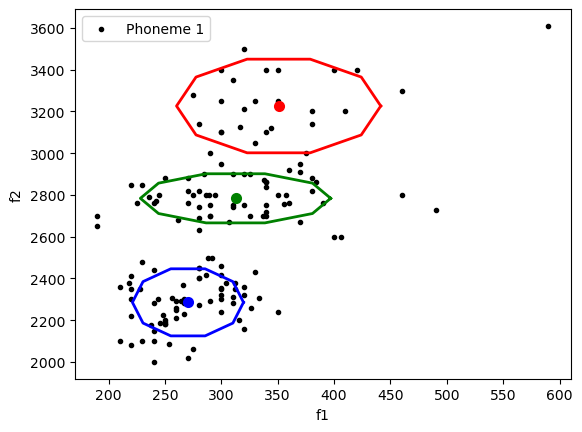

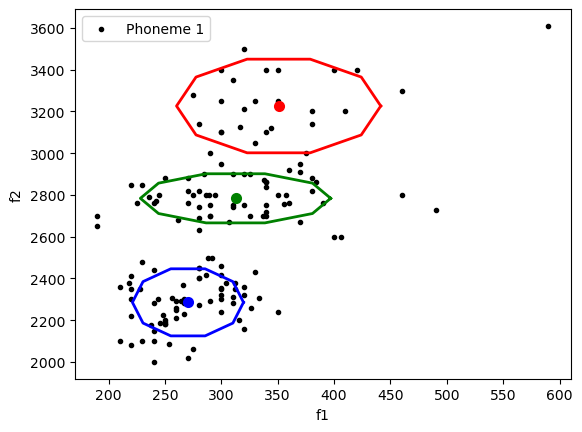

In [14]:
### your code here
# Q2)  k=3, same p_id
_ = estimate_guass(k=3, p_id=1)

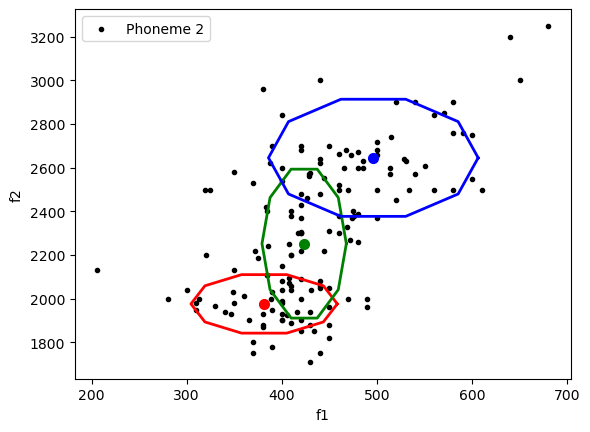


Finished.

[[ 381.35764 1976.0258 ]
 [ 423.43094 2252.1833 ]
 [ 496.1309  2645.5623 ]] [[[ 2960.17399628     0.        ]
  [    0.          9932.26856121]]

 [[  982.98828946     0.        ]
  [    0.         64393.92225471]]

 [[ 6073.62813022     0.        ]
  [    0.         39824.53363338]]]
Saving model


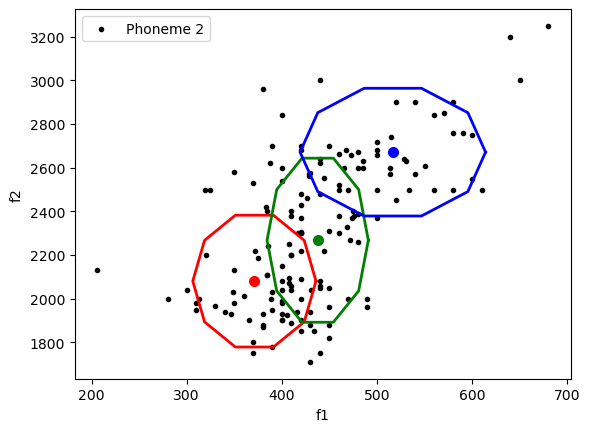

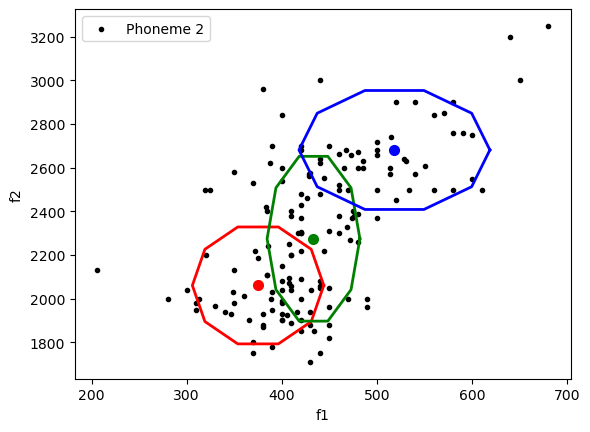

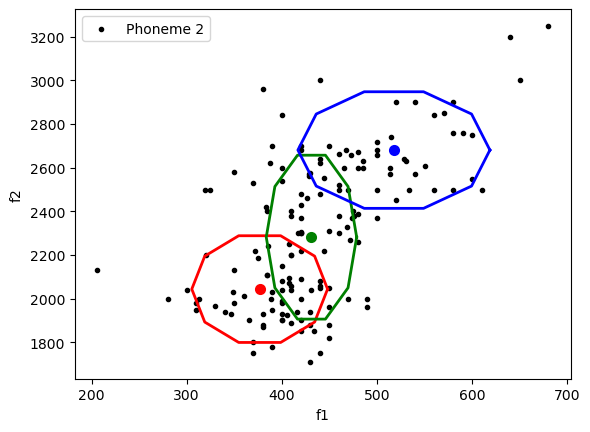

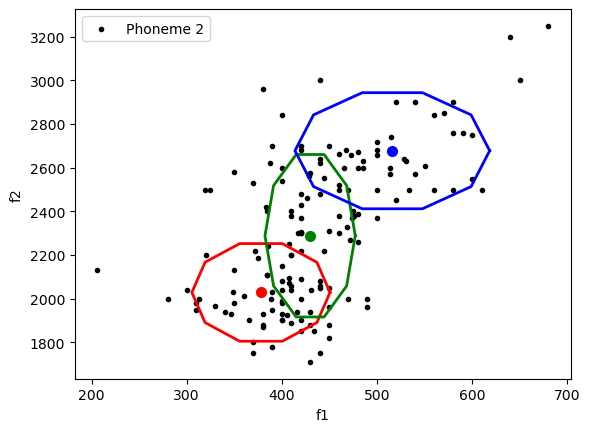

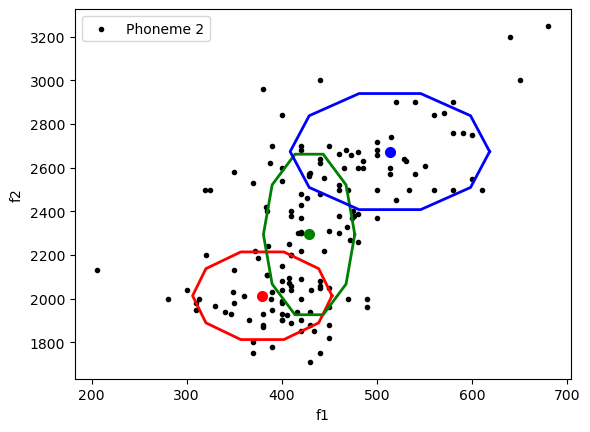

...

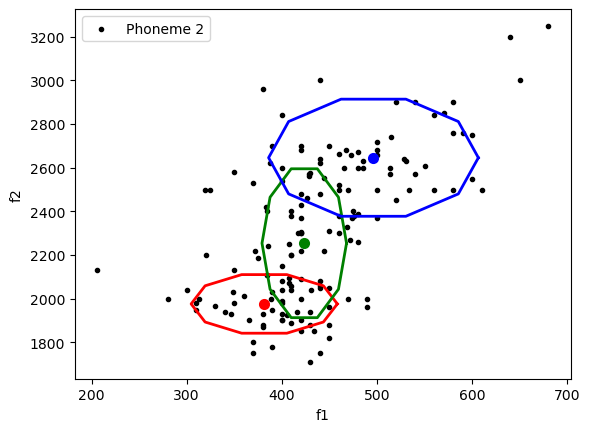

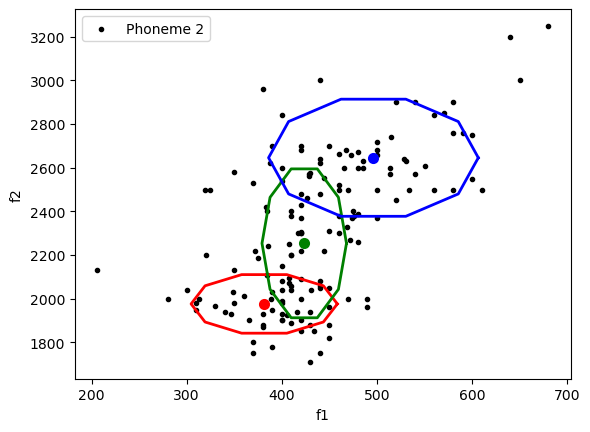

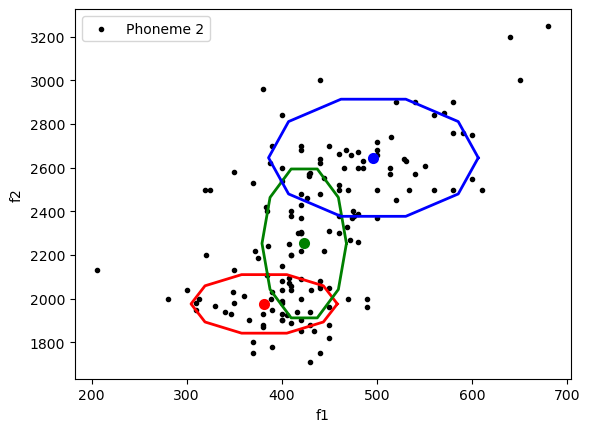

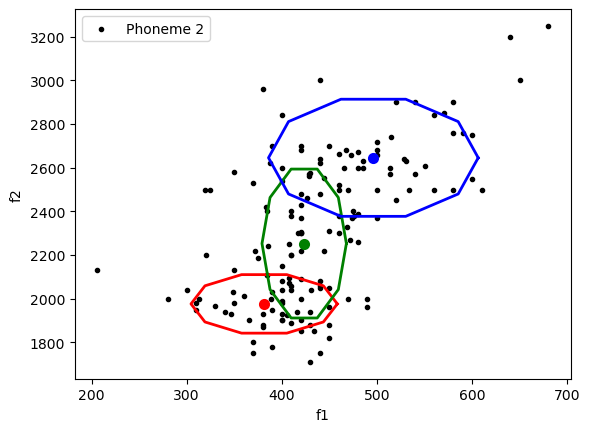

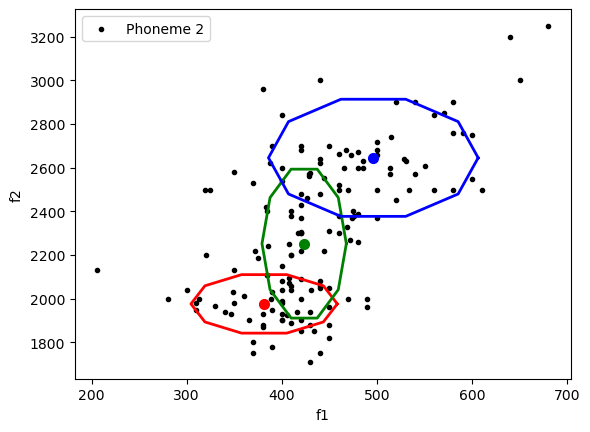

In [15]:
# Q3) p_id=2
_= estimate_guass(k=3, p_id=2)

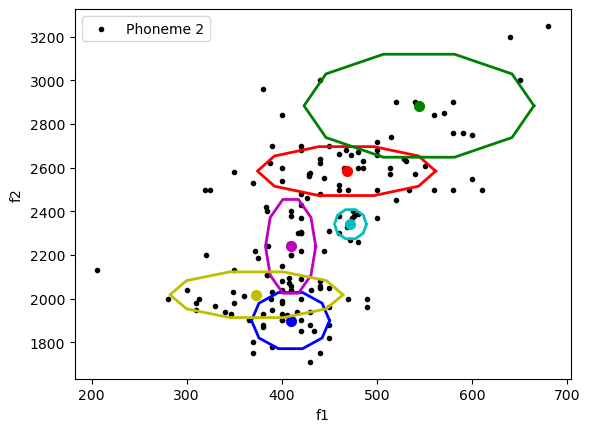


Finished.

[[ 467.94476 2584.6445 ]
 [ 544.1234  2884.2249 ]
 [ 409.09836 1899.4608 ]
 [ 472.10483 2341.2551 ]
 [ 409.18613 2239.7068 ]
 [ 373.3083  2017.9832 ]] [[[ 4384.3814299      0.        ]
  [    0.          6944.4110523 ]]

 [[ 7302.65102534     0.        ]
  [    0.         30793.08423086]]

 [[  841.91114592     0.        ]
  [    0.          9162.7014929 ]]

 [[  140.20513086     0.        ]
  [    0.          2453.78577927]]

 [[  349.4475864      0.        ]
  [    0.         25530.1027793 ]]

 [[ 4128.39759297     0.        ]
  [    0.          6065.82286299]]]
Saving model


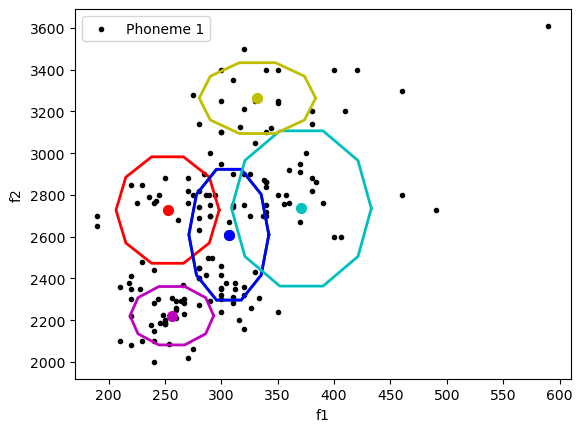

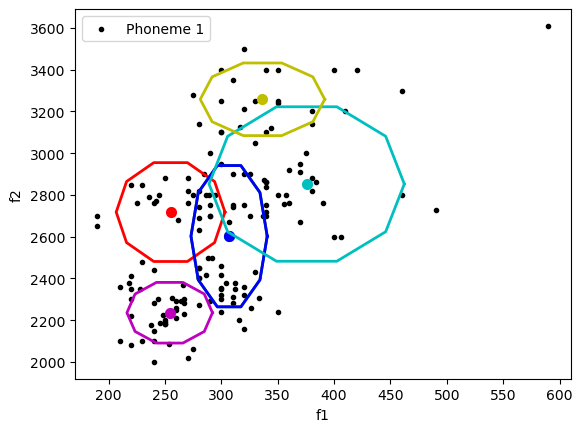

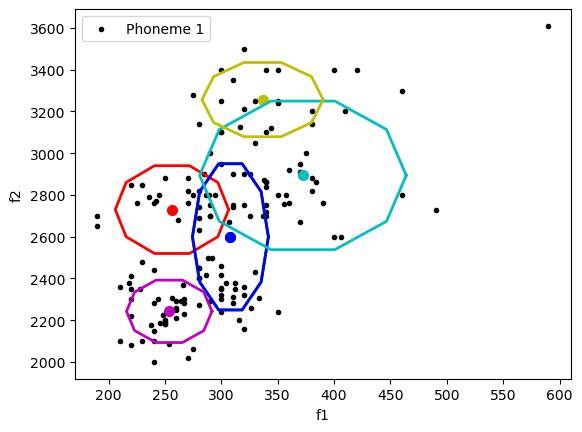

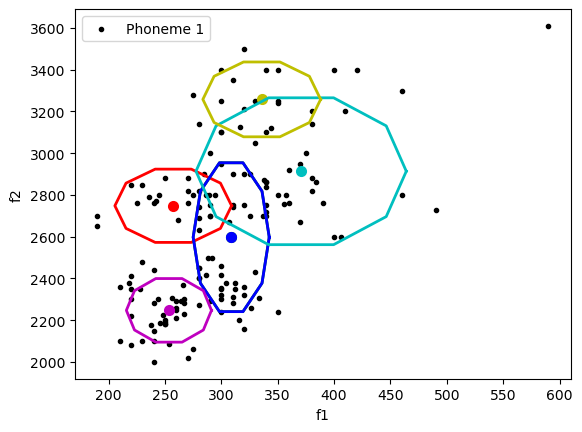

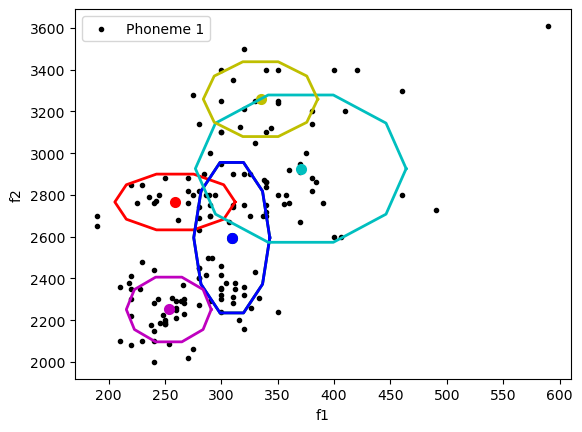

...

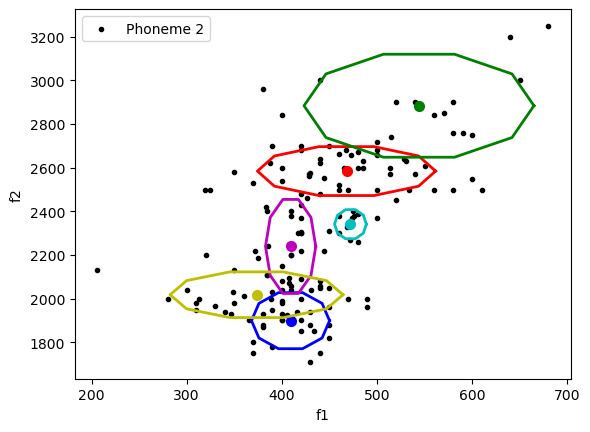

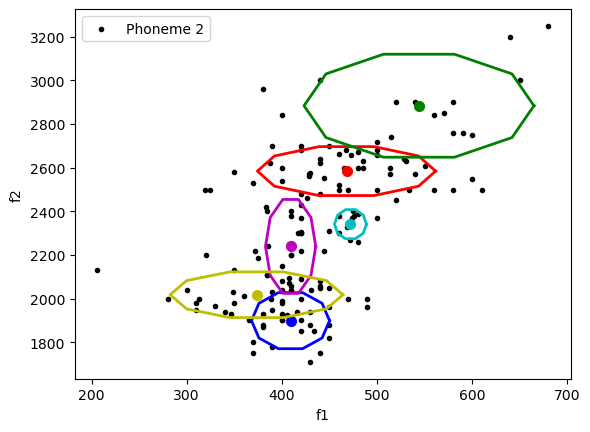

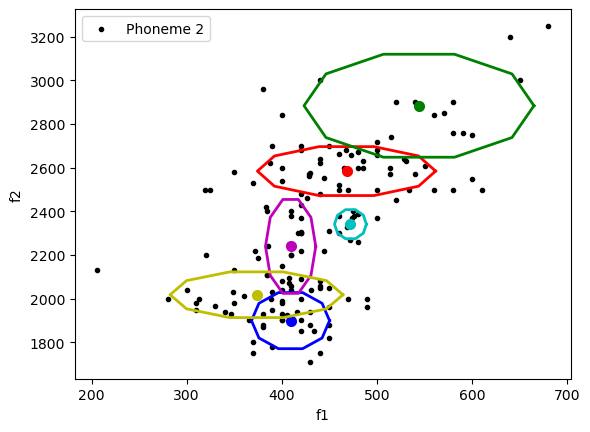

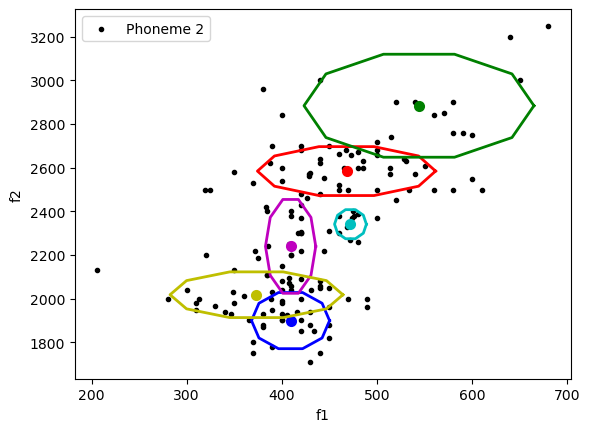

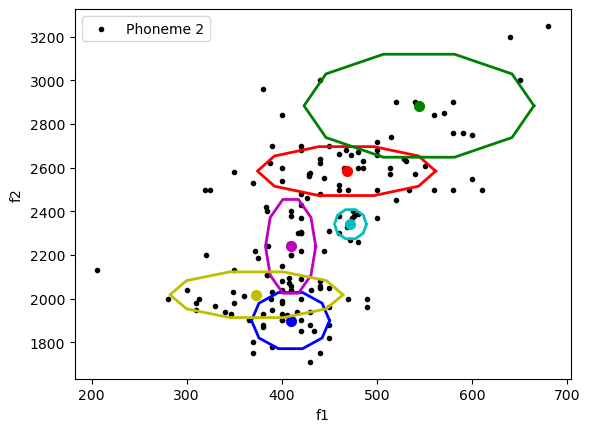

In [16]:
# Q4) K =6, p_id=1 and also for p_id=2
estimate_guass(k=6, p_id=1)
estimate_guass(k=6, p_id=2)

### <font color="maroon"> Q5. Use the 2 MoGs ($K=3$) learnt in tasks 2 & 3 to build a classifier to discriminate between phonemes 1 and 2, and explain the process in the report [4 marks] </font>

Classify using the Maximum Likelihood (ML) criterion and calculate the miss-classification error. Remember that a classification under the ML compares $p(\mathbf{x};\boldsymbol\theta_{1})$, where $\boldsymbol\theta_{1}$ are the parameters of the MoG learnt for the first phoneme, with $p(\mathbf{x};\boldsymbol\theta_{2})$, where $\boldsymbol\theta_{2}$  are the parameters of the MoG learnt for the second phoneme.

In [17]:
k = 3
inds_1 = np.where(phoneme_id==1)
inds_2 = np.where(phoneme_id==2)
inds_1 = inds_1[0]
inds_2 = inds_2[0]
inds_1_and_2 = np.concatenate((inds_1, inds_2), axis=0)

X = X_full[inds_1_and_2,:]

N = X.shape[0]
D = X.shape[1]

# Get predictions on both phonemes 1 and 2, from a GMM with k components, pretrained on phoneme 1
p_id = 1
npy_filename = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(p_id, k)
if os.path.isfile(npy_filename):
    GMM_parameters_phoneme_1 = np.load(npy_filename, allow_pickle=True)
    GMM_parameters_phoneme_1 = np.ndarray.tolist(GMM_parameters_phoneme_1)
else:
    raise('File {} does not exist.'.format(npy_filename))
mu = GMM_parameters_phoneme_1['mu']
s = GMM_parameters_phoneme_1['s']
p = GMM_parameters_phoneme_1['p']

print(f"phoneme 1 mean: {mu.shape}")
print(f"phoneme 1 covariance matrix: {s, s.shape}")
# Based on data, looks like covariance is 0, just variance in x and y.

print(f"phoneme 1 model coeffiecent: {p.shape}")


# Initialize array Z_phoneme_1 that will get the predictions of each Gaussian on each sample
Z_phoneme_1 = np.zeros((N,k)) # shape Nxk

# get predictions
###your code here
print(f"x sample: {X[0], X[0].shape}")
Z_phoneme_1 = get_predictions(mu, s, p, X)  # P(x | class=phenome1)
print(Z_phoneme_1.shape)  # N, k
#print(np.sum(Z_phoneme_1, axis=1).reshape(-1, 1))


# Get predictions on both phonemes 1 and 2, from a GMM with k components, pretrained on phoneme 2
p_id = 2
###your code here
npy_filename = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(p_id, k)
if os.path.isfile(npy_filename):
    GMM_parameters_phoneme_2 = np.load(npy_filename, allow_pickle=True)
    GMM_parameters_phoneme_2 = np.ndarray.tolist(GMM_parameters_phoneme_2)
else:
    raise('File {} does not exist.'.format(npy_filename))
mu2 = GMM_parameters_phoneme_2['mu']
s2 = GMM_parameters_phoneme_2['s']
p2 = GMM_parameters_phoneme_2['p']

Z_phoneme_2 = np.zeros((N,k)) # shape Nxk
Z_phoneme_2 = get_predictions(mu2, s2, p2, X)  # P(x | class=phenome2)

# classify each point using Maximum Likelihood
### your code here
# Using Bayes Theorem

def classify(phoneme_pred1, phoneme_pred2):
    p_phoneme_1 = inds_1.shape[0] / N
    p_phoneme_2 = inds_2.shape[0] / N
    if np.sum(phoneme_pred1 * p_phoneme_1) >= np.sum(phoneme_pred2 * p_phoneme_2) :
        return 1.0
    return 2.0


classify(Z_phoneme_1[-1], Z_phoneme_2[-1])
      
# calculate accuracy
### your code here
print(len(inds_1), X.shape)
correct_count = 0
for index, sample in enumerate(zip(Z_phoneme_1, Z_phoneme_2)):
    pred_1, pred_2 = sample
    if index < len(inds_1):
        true_label = 1
    else:
        true_label = 2
    y_hat = classify(pred_1, pred_2)
    if y_hat == true_label:
        correct_count +=1
    # else:
    #     print(f"Wrong prediction for index: {index}")
accuracy =  (correct_count / Z_phoneme_1.shape[0])
print(f"Accuracy for K={k}: {accuracy*100:.2f} %")
print(f"Misclassification Error: {(1-accuracy) * 100:2f} %")

phoneme 1 mean: (3, 2)
phoneme 1 covariance matrix: (array([[[ 4102.87537479,     0.        ],
        [    0.        , 27829.54222673]],

       [[ 3562.59743767,     0.        ],
        [    0.        ,  7657.84897123]],

       [[ 1213.73843494,     0.        ],
        [    0.        , 14278.42029969]]]), (3, 2, 2))
phoneme 1 model coeffiecent: (3,)
x sample: (array([ 240., 2280.], dtype=float32), (2,))
[[ 4102.87537479     0.        ]
 [    0.         27829.54222673]] s [i]
[[3562.59743767    0.        ]
 [   0.         7657.84897123]] s [i]
[[ 1213.73843494     0.        ]
 [    0.         14278.42029969]] s [i]
(304, 3)
[[2960.17399628    0.        ]
 [   0.         9932.26856121]] s [i]
[[  982.98828946     0.        ]
 [    0.         64393.92225471]] s [i]
[[ 6073.62813022     0.        ]
 [    0.         39824.53363338]] s [i]
152 (304, 2)
Accuracy for K=3: 96.38 %
Misclassification Error: 3.618421 %


### <font color="maroon"> Q6. Repeat for $K=6$ and compare the results in terms of accuracy. [2 mark] </font>


In [18]:
k = 6
inds_1 = np.where(phoneme_id==1)
inds_2 = np.where(phoneme_id==2)
inds_1 = inds_1[0]
inds_2 = inds_2[0]
inds_1_and_2 = np.concatenate((inds_1, inds_2), axis=0)

X = X_full[inds_1_and_2,:]

N = X.shape[0]
D = X.shape[1]

# Get predictions on both phonemes 1 and 2, from a GMM with k components, pretrained on phoneme 1
p_id = 1
npy_filename = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(p_id, k)
if os.path.isfile(npy_filename):
    GMM_parameters_phoneme_1 = np.load(npy_filename, allow_pickle=True)
    GMM_parameters_phoneme_1 = np.ndarray.tolist(GMM_parameters_phoneme_1)
else:
    raise('File {} does not exist.'.format(npy_filename))
mu = GMM_parameters_phoneme_1['mu']
s = GMM_parameters_phoneme_1['s']
p = GMM_parameters_phoneme_1['p']

print(f"phoneme 1 mean: {mu.shape}")
print(f"phoneme 1 covariance matrix: {s, s.shape}")
# Based on data, looks like covariance is 0, just variance in x and y.

print(f"phoneme 1 model coeffiecent: {p.shape}")


# Initialize array Z_phoneme_1 that will get the predictions of each Gaussian on each sample
Z_phoneme_1 = np.zeros((N,k)) # shape Nxk

# get predictions
###your code here
print(f"x sample: {X[0]}")
Z_phoneme_1 = get_predictions(mu, s, p, X)  # P(x | class=phenome1)
#print(Z_phoneme_1)  # N, k
#print(np.sum(Z_phoneme_1, axis=1).reshape(-1, 1))


# Get predictions on both phonemes 1 and 2, from a GMM with k components, pretrained on phoneme 2
p_id = 2
###your code here
npy_filename = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(p_id, k)
if os.path.isfile(npy_filename):
    GMM_parameters_phoneme_2 = np.load(npy_filename, allow_pickle=True)
    GMM_parameters_phoneme_2 = np.ndarray.tolist(GMM_parameters_phoneme_2)
else:
    raise('File {} does not exist.'.format(npy_filename))
mu2 = GMM_parameters_phoneme_2['mu']
s2 = GMM_parameters_phoneme_2['s']
p2 = GMM_parameters_phoneme_2['p']

Z_phoneme_2 = np.zeros((N,k)) # shape Nxk
Z_phoneme_2 = get_predictions(mu2, s2, p2, X)  # P(x | class=phenome2)

# classify each point using Maximum Likelihood
### your code here
# Using Bayes Theorem

def classify(phoneme_pred1, phoneme_pred2):
    p_phoneme_1 = inds_1.shape[0] / N
    p_phoneme_2 = inds_2.shape[0] / N
    if np.sum(phoneme_pred1 * p_phoneme_1) >= np.sum(phoneme_pred2 * p_phoneme_2) :
        return 1
    return 2


classify(Z_phoneme_1[-1], Z_phoneme_2[-1])
      
# calculate accuracy
### your code here
print(len(inds_1), X.shape)
correct_count = 0
for index, sample in enumerate(zip(Z_phoneme_1, Z_phoneme_2)):
    pred_1, pred_2 = sample
    if index < len(inds_1):
        true_label = 1.0
    else:
        true_label = 2.0
    y_hat = classify(pred_1, pred_2)
    if y_hat == true_label:
        correct_count +=1
    # else:
    #     print(f"Wrong prediction for index: {index}")
accuracy =  (correct_count / Z_phoneme_1.shape[0])
print(f"Accuracy for K={k}: {accuracy*100:.2f} %")
print(f"Misclassification Error: {(1-accuracy) * 100:2f} %")

phoneme 1 mean: (6, 2)
phoneme 1 covariance matrix: (array([[[ 3683.87399293,     0.        ],
        [    0.        ,  7054.01867635]],

       [[  401.39197515,     0.        ],
        [    0.        ,  7241.79474108]],

       [[  401.39197515,     0.        ],
        [    0.        ,  7241.79474108]],

       [[ 7474.49350496,     0.        ],
        [    0.        , 16556.89513522]],

       [[  356.20145426,     0.        ],
        [    0.        , 14190.82515069]],

       [[ 1251.81797967,     0.        ],
        [    0.        , 27149.06310925]]]), (6, 2, 2))
phoneme 1 model coeffiecent: (6,)
x sample: [ 240. 2280.]
[[3683.87399293    0.        ]
 [   0.         7054.01867635]] s [i]
[[ 401.39197515    0.        ]
 [   0.         7241.79474108]] s [i]
[[ 401.39197515    0.        ]
 [   0.         7241.79474108]] s [i]
[[ 7474.49350496     0.        ]
 [    0.         16556.89513522]] s [i]
[[  356.20145426     0.        ]
 [    0.         14190.82515069]] s [i]
[[ 1251.

### <font color="maroon"> Q7. Display a "classification matrix" assigning labels to a grid of all combinations of the $F1$ and $F2$ features for the $K=3$ classifiers from above. Next, repeat this step for $K=6$ and compare the two. [3 marks] </font>

In particular,
create a custom uniform grid of points that spans all possible intermediate combinations of $F1$ and $F2$ features, using the features' minimum and maximum values as the limits. (Hint: check documentation for [np.meshgrid](https://numpy.org/doc/stable/reference/generated/numpy.meshgrid.html) and [np.linspace](https://numpy.org/doc/stable/reference/generated/numpy.linspace.html) ). Classify each point in the grid using one of your classifiers. That is, create a classification matrix, $\mathbf{M}$, whose elements are either 0 or 1. $M(i,j)$ is 0 if the point at location $(i,j)$ on the custom grid is classified as belonging to phoneme 1, and is 1 otherwise.

### Hint: building the custom grid:
Assuming our data were the orange points below, the custom grid would look something like the following (evenly spaced points spanning the minimum to maximum values of both features):

![](https://i.imgur.com/khfYx42.png)



f1 range: 190-680 | 490 points
f2 range: 1710-3610 | 1900 points
(931000, 2)
[[ 190 1710]
 [ 191 1710]
 [ 192 1710]
 ...
 [ 677 3610]
 [ 678 3610]
 [ 680 3610]]
running predictions
(931000, 2)
[[ 365.77104812    0.        ]
 [   0.         6568.98447513]] s [i]
[[  356.12435852     0.        ]
 [    0.         13577.91929416]] s [i]
[[ 4002.5369457      0.        ]
 [    0.         67340.67891838]] s [i]
[[ 2808.92475185     0.        ]
 [    0.         29721.61216709]] s [i]
[[ 2111.86921952     0.        ]
 [    0.         49424.45171729]] s [i]
[[ 2454.93846957     0.        ]
 [    0.         15262.62256021]] s [i]
(931000, 3) (931000, 3) phoneme pred shape
0.5 0.5
[1 1 1 ... 1 1 1]
reshape the predictions to meshgrid shape with clusters 3
(931000,)


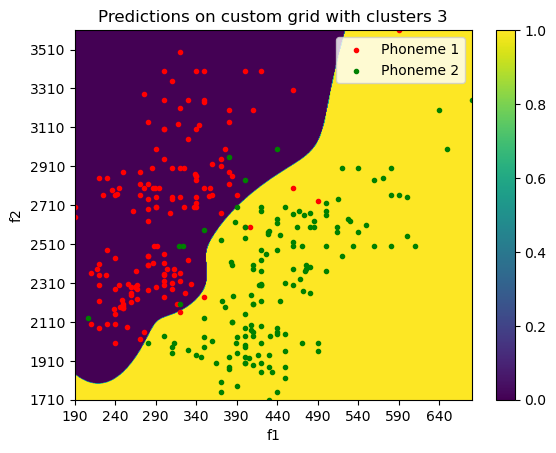

In [18]:
from tqdm import tqdm
k = 3
npy_filename1 = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(1, k)
if os.path.isfile(npy_filename):
    GMM_parameters_phoneme_1 = np.load(npy_filename1, allow_pickle=True)
    GMM_parameters_phoneme_1 = np.ndarray.tolist(GMM_parameters_phoneme_1)
else:
    raise('File {} does not exist.'.format(npy_filename1))
mu = GMM_parameters_phoneme_1['mu']
s = GMM_parameters_phoneme_1['s']
p = GMM_parameters_phoneme_1['p']

npy_filename2 = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(2, k)
if os.path.isfile(npy_filename2):
    GMM_parameters_phoneme_2 = np.load(npy_filename2, allow_pickle=True)
    GMM_parameters_phoneme_2 = np.ndarray.tolist(GMM_parameters_phoneme_2)
else:
    raise('File {} does not exist.'.format(npy_filename2))
mu2 = GMM_parameters_phoneme_2['mu']
s2 = GMM_parameters_phoneme_2['s']
p2 = GMM_parameters_phoneme_2['p']



def classify(sample, k=3):
    print(sample.shape)  # N,d
    phoneme_pred1 = get_predictions(mu, s, p, sample)
    phoneme_pred2 = get_predictions(mu2, s2, p2, sample)
    
    print(phoneme_pred1.shape, phoneme_pred2.shape, "phoneme pred shape")

    
    p_phoneme_1 = inds_1.shape[0] / N
    p_phoneme_2 = inds_2.shape[0] / N
    print(p_phoneme_1, p_phoneme_2)
    sum_phoneme1 = np.sum(phoneme_pred1 * p_phoneme_1, axis=1) # N, (dxk)
    sum_phoneme2 = np.sum(phoneme_pred2 * p_phoneme_2, axis=1)
    
    #print("summed phoneme1 pred shape", sum_phoneme1)
    # N,1 shape
    # if sum_phoneme1 > sum_phoneme2, place a 0 at space else place a 1
    result = (sum_phoneme1 < sum_phoneme2).astype(int)
    print(result)
    return result



X = X_full[inds_1_and_2,:]

N = X.shape[0]
D = X.shape[1]

min_f1 = int(np.min(X[:,0]))
max_f1 = int(np.max(X[:,0]))
min_f2 = int(np.min(X[:,1]))
max_f2 = int(np.max(X[:,1]))
N_f1 = max_f1 - min_f1
N_f2 = max_f2 - min_f2
print('f1 range: {}-{} | {} points'.format(min_f1, max_f1, N_f1))
print('f2 range: {}-{} | {} points'.format(min_f2, max_f2, N_f2))

#########################################
# Write your code here
# Create a custom grid of shape N_f1 x N_f2

M = np.zeros((N_f1, N_f2))  # Initialize grid

f1_count = np.linspace(min_f1, max_f1, N_f1)
f2_count = np.linspace(min_f2, max_f2, N_f2)

# Create a meshgrid for f1 and f2
f1_vals, f2_vals = np.meshgrid(f1_count, f2_count)

# Reshape the meshgrid into a 2D array where each row is a (f1, f2) pair
grid_samples = np.column_stack((f1_vals.ravel(), f2_vals.ravel())).astype(int)
print(grid_samples.shape)
print(grid_samples)
print("running predictions")
# Classify each point on the grid using vectorized operations
predictions = classify(grid_samples, k)

print(f"reshape the predictions to meshgrid shape with clusters {k}")
# Reshape the predictions back to the shape of the meshgrid
print(predictions.shape)
M = predictions.reshape(f1_vals.shape)

# Then, classify each point [i.e., each (f1, f2) pair] of that grid, to either phoneme 1, or phoneme 2, using the two trained GMMs
# Do predictions, using GMM trained on phoneme 1, on custom grid
# Do predictions, using GMM trained on phoneme 2, on custom grid
# Compare these predictions, to classify each point of the grid
# Store these prediction in a 2D numpy array named "M", of shape N_f2 x N_f1 (the first dimension is f2 so that we keep f2 in the vertical axis of the plot)
# M should contain "0.0" in the points that belong to phoneme 1 and "1.0" in the points that belong to phoneme 2
########################################/

################################################
# Visualize predictions on custom grid

# Create a figure
#fig = plt.figure()
fig, ax = plt.subplots()

# use aspect='auto' (default is 'equal'), to force the plotted image to be square, when dimensions are unequal
plt.imshow(M, aspect='auto')

# set label of x axis
ax.set_xlabel('f1')
# set label of y axis
ax.set_ylabel('f2')

# set limits of axes
plt.xlim((0, N_f1))
plt.ylim((0, N_f2))

# set range and strings of ticks on axes
x_range = np.arange(0, N_f1, step=50)
x_strings = [str(x+min_f1) for x in x_range]
plt.xticks(x_range, x_strings)
y_range = np.arange(0, N_f2, step=200)
y_strings = [str(y+min_f2) for y in y_range]
plt.yticks(y_range, y_strings)

# set title of figure
title_string = f'Predictions on custom grid with clusters {k}'
plt.title(title_string)

# add a colorbar
plt.colorbar()

N_samples = int(X.shape[0]/2)
plt.scatter(X[:N_samples, 0] - min_f1, X[:N_samples, 1] - min_f2, marker='.', color='red', label='Phoneme 1')
plt.scatter(X[N_samples:, 0] - min_f1, X[N_samples:, 1] - min_f2, marker='.', color='green', label='Phoneme 2')

# add legend to the subplot
plt.legend()
plt.show()

### Same code but for cluster k=6

f1 range: 190-680 | 490 points
f2 range: 1710-3610 | 1900 points
(931000, 2)
[[ 190 1710]
 [ 191 1710]
 [ 192 1710]
 ...
 [ 677 3610]
 [ 678 3610]
 [ 680 3610]]
running predictions
(931000, 2)
[[ 401.23535603    0.        ]
 [   0.         7254.33453754]] s [i]
[[ 405.79598846    0.        ]
 [   0.         4858.1592666 ]] s [i]
[[  356.12741001     0.        ]
 [    0.         14192.02578622]] s [i]
[[1190.66434344    0.        ]
 [   0.         5473.08489946]] s [i]
[[ 4182.94341964     0.        ]
 [    0.         25732.57259213]] s [i]
[[6211.60007372    0.        ]
 [   0.         3839.95969602]] s [i]
[[  868.69712217     0.        ]
 [    0.         10421.80799433]] s [i]
[[4161.7279896     0.        ]
 [   0.         6245.36823018]] s [i]
[[  343.37469023     0.        ]
 [    0.         21537.66877304]] s [i]
[[4378.98456444    0.        ]
 [   0.         6935.86329311]] s [i]
[[ 140.37074622    0.        ]
 [   0.         2453.78635174]] s [i]
[[ 7314.06795157     0.        ]

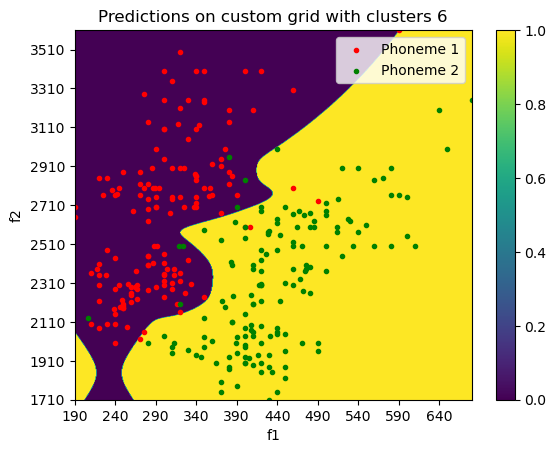

In [19]:
from tqdm import tqdm
k = 6
npy_filename1 = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(1, k)
if os.path.isfile(npy_filename):
    GMM_parameters_phoneme_1 = np.load(npy_filename1, allow_pickle=True)
    GMM_parameters_phoneme_1 = np.ndarray.tolist(GMM_parameters_phoneme_1)
else:
    raise('File {} does not exist.'.format(npy_filename1))
mu = GMM_parameters_phoneme_1['mu']
s = GMM_parameters_phoneme_1['s']
p = GMM_parameters_phoneme_1['p']

npy_filename2 = 'data/GMM_params_phoneme_{:02}_k_{:02}.npy'.format(2, k)
if os.path.isfile(npy_filename2):
    GMM_parameters_phoneme_2 = np.load(npy_filename2, allow_pickle=True)
    GMM_parameters_phoneme_2 = np.ndarray.tolist(GMM_parameters_phoneme_2)
else:
    raise('File {} does not exist.'.format(npy_filename2))
mu2 = GMM_parameters_phoneme_2['mu']
s2 = GMM_parameters_phoneme_2['s']
p2 = GMM_parameters_phoneme_2['p']



def classify(sample, k=3):
    print(sample.shape)  # N,d
    phoneme_pred1 = get_predictions(mu, s, p, sample)
    phoneme_pred2 = get_predictions(mu2, s2, p2, sample)
    
    print(phoneme_pred1.shape, phoneme_pred2.shape, "phoneme pred shape")

    
    p_phoneme_1 = inds_1.shape[0] / N
    p_phoneme_2 = inds_2.shape[0] / N
    print(p_phoneme_1, p_phoneme_2)
    sum_phoneme1 = np.sum(phoneme_pred1 * p_phoneme_1, axis=1) # N, (dxk)
    sum_phoneme2 = np.sum(phoneme_pred2 * p_phoneme_2, axis=1)
    
    #print("summed phoneme1 pred shape", sum_phoneme1)
    # N,1 shape
    # if sum_phoneme1 > sum_phoneme2, place a 0 at space else place a 1
    result = (sum_phoneme1 < sum_phoneme2).astype(int)
    print(result)
    return result



X = X_full[inds_1_and_2,:]

N = X.shape[0]
D = X.shape[1]

min_f1 = int(np.min(X[:,0]))
max_f1 = int(np.max(X[:,0]))
min_f2 = int(np.min(X[:,1]))
max_f2 = int(np.max(X[:,1]))
N_f1 = max_f1 - min_f1
N_f2 = max_f2 - min_f2
print('f1 range: {}-{} | {} points'.format(min_f1, max_f1, N_f1))
print('f2 range: {}-{} | {} points'.format(min_f2, max_f2, N_f2))

#########################################
# Write your code here
# Create a custom grid of shape N_f1 x N_f2

M = np.zeros((N_f1, N_f2))  # Initialize grid

# Create a meshgrid for f1 and f2

f1_count = np.linspace(min_f1, max_f1, N_f1)
f2_count = np.linspace(min_f2, max_f2, N_f2)

f1_vals, f2_vals = np.meshgrid(f1_count, f2_count)

# Reshape the meshgrid into a 2D array where each row is a (f1, f2) pair
grid_samples = np.column_stack((f1_vals.ravel(), f2_vals.ravel())).astype(int)
print(grid_samples.shape)
print(grid_samples)
print("running predictions")
# Classify each point on the grid using vectorized operations
predictions = classify(grid_samples, k)

print(f"reshape the predictions to meshgrid shape with clusters {k}")
# Reshape the predictions back to the shape of the meshgrid
print(predictions.shape)
M = predictions.reshape(f1_vals.shape)

# Then, classify each point [i.e., each (f1, f2) pair] of that grid, to either phoneme 1, or phoneme 2, using the two trained GMMs
# Do predictions, using GMM trained on phoneme 1, on custom grid
# Do predictions, using GMM trained on phoneme 2, on custom grid
# Compare these predictions, to classify each point of the grid
# Store these prediction in a 2D numpy array named "M", of shape N_f2 x N_f1 (the first dimension is f2 so that we keep f2 in the vertical axis of the plot)
# M should contain "0.0" in the points that belong to phoneme 1 and "1.0" in the points that belong to phoneme 2
########################################/

################################################
# Visualize predictions on custom grid

# Create a figure
#fig = plt.figure()
fig, ax = plt.subplots()

# use aspect='auto' (default is 'equal'), to force the plotted image to be square, when dimensions are unequal
plt.imshow(M, aspect='auto')

# set label of x axis
ax.set_xlabel('f1')
# set label of y axis
ax.set_ylabel('f2')

# set limits of axes
plt.xlim((0, N_f1))
plt.ylim((0, N_f2))

# set range and strings of ticks on axes
x_range = np.arange(0, N_f1, step=50)
x_strings = [str(x+min_f1) for x in x_range]
plt.xticks(x_range, x_strings)
y_range = np.arange(0, N_f2, step=200)
y_strings = [str(y+min_f2) for y in y_range]
plt.yticks(y_range, y_strings)

# set title of figure
title_string = f'Predictions on custom grid with clusters {k}'
plt.title(title_string)

# add a colorbar
plt.colorbar()

N_samples = int(X.shape[0]/2)
plt.scatter(X[:N_samples, 0] - min_f1, X[:N_samples, 1] - min_f2, marker='.', color='red', label='Phoneme 1')
plt.scatter(X[N_samples:, 0] - min_f1, X[N_samples:, 1] - min_f2, marker='.', color='green', label='Phoneme 2')

# add legend to the subplot
plt.legend()
plt.show()

Create a new dataset that will contain 3 columns, as follows:
\begin{equation}
    X = [F1, F2, F1+F2]
\end{equation}

### <font color="maroon"> Q8. Try to fit a MoG model to the new data. What is the problem that you observe? Explain why it occurs [2 marks]

In [ ]:
p_id = 1 # id of the phoneme that will be used (e.g. 1, or 2)

k = 3 # number of GMM components
X = np.zeros((len(f1), 3))
#########################################
# Write your code here
# The shape of X is be two-dimensional. Each row will represent a sample of the dataset, and each column will represent a feature (e.g. f1 or f2 or f1+f2)
# Store f1 in the first column of X, f2 in the second column of X and f1+f2 in the third column of X
# Filter X to, contain only samples that belong to the chosen phoneme.







#########################################
fig = plt.figure()
ax1 = plt.axes(projection='3d')
title_string = 'Phoneme {}'.format(p_id)
plot_data_3D(X=X, title_string=title_string, ax=ax1)

N, D = X.shape
p = np.ones((k))/k
random_indices = np.floor(N*np.random.rand((k)))
random_indices = random_indices.astype(int)
mu = X[random_indices,:] # shape kxD
s = np.zeros((k,D,D)) # shape kxDxD
n_iter = 150

# initialize covariances
for i in range(k):
    cov_matrix = np.cov(X.transpose())
    s[i,:,:] = cov_matrix/k

Z = np.zeros((N,k)) # shape Nxk

###############################
# run Expectation Maximization algorithm for n_iter iterations
for t in range(n_iter):
    #print('****************************************')
    print('Iteration {:03}/{:03}'.format(t+1, n_iter))

    # Do the E-step
    Z = get_predictions(mu, s, p, X)
    Z = normalize(Z, axis=1, norm='l1')
    # Do the M-step:
    for i in range(k):
        mu[i,:] = np.matmul(X.transpose(), Z[:,i])/np.sum(Z[:,i])

        ###################################################
        # We will fit Gaussians with full covariance matrices:
        mu_i = mu[i,:]
        mu_i = np.expand_dims(mu_i, axis=1)
        mu_i_repeated = np.repeat(mu_i, N, axis=1)

        term_1 = X.transpose() - mu_i_repeated
        term_2 = np.repeat(np.expand_dims(Z[:,i], axis=1), D, axis=1) * term_1.transpose()
        s[i,:,:] = np.matmul(term_1, term_2)/np.sum(Z[:,i])
        p[i] = np.mean(Z[:,i])

plot_gaussians(ax1, 2*s, mu, X, 'Phoneme {}'.format(p_id))
plt.show()

In [20]:
print(f1.shape, f2.shape, (f1+f2).shape)

X = np.array([f1, f2, (f1+f2)]).T
print(X.shape)  

inds_1 = np.where(phoneme_id==1)
inds_1 = inds_1[0]
X = X[inds_1, :]
X.shape

# Transpose, obtains the 3, from the N.

(1520,) (1520,) (1520,)
(1520, 3)


(152, 3)

In [21]:
def get_predictions(mu, s, p, X):

    # get number of GMM components / clusters
    k = s.shape[0]
    # get number of data samples
    N = X.shape[0]
    # get dimensionality of our dataset
    D = X.shape[1]
    
    Z = np.zeros((N, k))
    for i in range(k):  # for each column.
        mu_i = mu[i, :]
        mu_i = np.expand_dims(mu_i, axis=1)  # [[m1], [m2],[m3]]  3,1 from 3,
        mu_i_repeated = np.repeat(mu_i, N, axis=1)  
        # within each element in axis 1, repeat it by N times ... [[m1, m1, m1, ..], [m2, m2, m2,....], [m3,m3,m3,....] ]  # 3,N
        X_minus_mu = X - mu_i_repeated.transpose() # X is N, d  - N, d , each coord is minus by the mean. 
        print(s[i], "s [i]")
        inverse_s = scipy.linalg.pinv(s[i])
        print("inverse _s: ", inverse_s)
        inverse_s = np.squeeze(inverse_s)
        s_i_det = scipy.linalg.det(s[i])
        print(s[i])
        print("determinant:", s_i_det)
        x_s_x = np.matmul(X_minus_mu, inverse_s)*X_minus_mu
        Z[:, i] = p[i]*(1/np.power(((2*np.pi)**D) * np.abs(s_i_det), 0.5)) * np.exp(-0.5*np.sum(x_s_x, axis=1))
    return Z


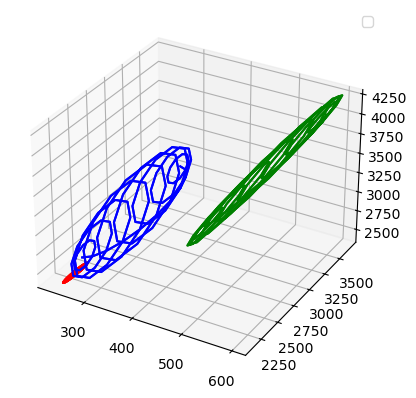

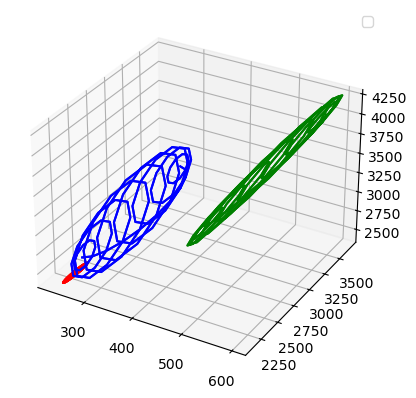

covar [[[1.08905328e+02 5.62753237e+02 6.71658265e+02]
  [5.62753237e+02 3.38277219e+03 3.94552512e+03]
  [6.71658265e+02 3.94552512e+03 4.61718369e+03]]

 [[3.07879720e+03 2.22513781e+04 2.53301751e+04]
  [2.22513781e+04 1.73307669e+05 1.95559047e+05]
  [2.53301751e+04 1.95559047e+05 2.20889222e+05]]

 [[2.73932378e+03 9.05191267e+03 1.17912363e+04]
  [9.05191267e+03 1.29559610e+05 1.38611522e+05]
  [1.17912363e+04 1.38611522e+05 1.50402759e+05]]]
mean [[ 251.95091 2211.5505  2463.5015 ]
 [ 521.5534  3086.192   3607.7454 ]
 [ 301.70914 2680.9973  2982.7065 ]]


In [21]:
p_id = 1 # id of the phoneme that will be used (e.g. 1, or 2)

k = 3 # number of GMM components
X = np.zeros((len(f1), 3))
#########################################
# Write your code here
# The shape of X is be two-dimensional. Each row will represent a sample of the dataset, and each column will represent a feature (e.g. f1 or f2 or f1+f2)
# Store f1 in the first column of X, f2 in the second column of X and f1+f2 in the third column of X
# Filter X to, contain only samples that belong to the chosen phoneme.
# 1520, 3
X = np.array([f1, f2, (f1+f2)]).T
# Filter by p_id given.
inds_1 = np.where(phoneme_id==1)
inds_1 = inds_1[0]
X = X[inds_1, :]
X = X.astype(np.float32)


#########################################
fig = plt.figure()
ax1 = plt.axes(projection='3d')
title_string = 'Phoneme {}'.format(p_id)
plot_data_3D(X=X, title_string=title_string, ax=ax1)



N, D = X.shape
p = np.ones((k))/k
random_indices = np.floor(N*np.random.rand((k)))
random_indices = random_indices.astype(int)
mu = X[random_indices,:] # shape kxD
s = np.zeros((k,D,D)) # shape kxDxD
n_iter = 150

# initialize covariances

# technique is to make comat consisting of the variance of each row of d,k.
#var_array = np.var(X.T, axis=1)
#print("var array shape", var_array.shape)
#technique_mat = var_array * np.identity(3)
#print(technique_mat.shape,)
for i in range(k):
    cov_matrix = np.cov(X.transpose())
    # initially set to fraction of data covariance
    s[i,:,:] = cov_matrix/k

Z = np.zeros((N,k)) # shape Nxk

###############################
# run Expectation Maximization algorithm for n_iter iterations
for t in range(n_iter):
    # print('****************************************')
    print('Iteration {:03}/{:03}'.format(t+1, n_iter))

    # Do the E-step
    #print("mu for prediction", mu)
    #print("X value", X[0])
    print("p value", p)
    
    Z = get_predictions(mu, s, p, X)
    #print("z ouput", Z.shape, Z)
    Z = normalize(Z, axis=1, norm='l1')
    
  
        
    #print("normalised predictions", Z.shape, Z)
    # Do the M-step:
    for i in range(k):
        mu[i,:] = np.matmul(X.transpose(), Z[:,i])/np.sum(Z[:,i])

        ###################################################
        # We will fit Gaussians with full covariance matrices:
        mu_i = mu[i,:]
        mu_i = np.expand_dims(mu_i, axis=1)
        mu_i_repeated = np.repeat(mu_i, N, axis=1)

        term_1 = X.transpose() - mu_i_repeated  # first term dim-mu
        term_2 = np.repeat(np.expand_dims(Z[:,i], axis=1), D, axis=1) * term_1.transpose()  # second term dim - mu
        print("Many reasons why this may given NAN, including division by inf or 0., Z gets 0 when prediction inversion fails.")
        s[i,:,:] = np.matmul(term_1, term_2)/np.sum(Z[:,i])


        # add small noise to s,
        s = s + (np.identity(D) * 0.0001)
        
         
        
        # print("s", s[i,:,:])
        p[i] = np.mean(Z[:,i])


    plot_data_3D(X=X, title_string=title_string, ax=ax1)
    plot_gaussians(ax1, 2*s, mu, X, f"Phoneme {p_id}")



    
    # technique_mat = var_array * np.identity(3)
    # s[i,:,:] =  technique_mat/k
    print("cov matrix", s[i,:,:])

plot_gaussians(ax1, 2*s, mu, X, 'Phoneme {}'.format(p_id))
plt.show()

print("covar", s)
print("mean", mu)


# We initialise the cov matrices, and are shown, which are three. 

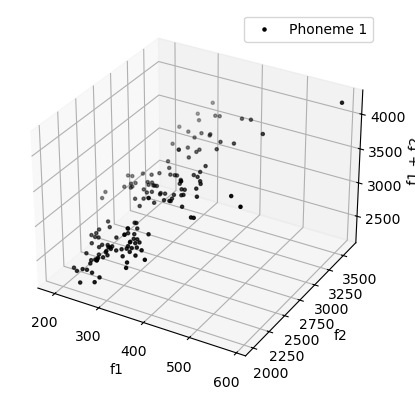

In [20]:

ax1 = plt.axes(projection='3d')
title_string = 'Phoneme {}'.format(p_id)
plot_data_3D(X=X, title_string=title_string, ax=ax1)

### <font color="maroon"> Q9. Suggest ways of overcoming the singularity problem and implement one of them. Show any training outputs in the report and discuss. [3 marks] </font>

Very simple for 3 marks, we have learnt 3 different techniques in lecture.

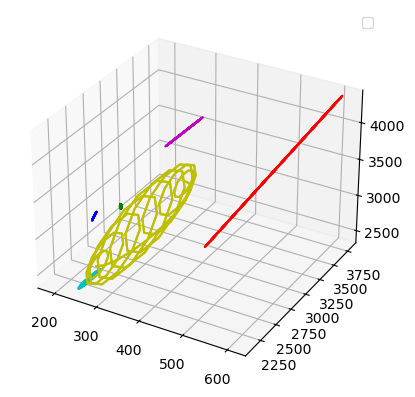

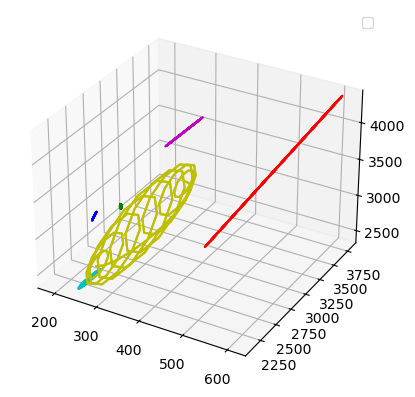

covarince [[[ 2.50000060e+03  2.20000000e+04  2.45000000e+04]
  [ 2.20000000e+04  1.93600001e+05  2.15600000e+05]
  [ 2.45000000e+04  2.15600000e+05  2.40100001e+05]]

 [[ 6.25572001e+00 -2.46794993e+01 -1.84242793e+01]
  [-2.46794993e+01  1.56570970e+02  1.31890971e+02]
  [-1.84242793e+01  1.31890971e+02  1.13467192e+02]]

 [[ 4.00000000e-04  0.00000000e+00  0.00000000e+00]
  [ 0.00000000e+00  6.25000400e+02  6.25000000e+02]
  [ 0.00000000e+00  6.25000000e+02  6.25000400e+02]]

 [[ 1.08030143e+02  5.58197866e+02  6.66227709e+02]
  [ 5.58197866e+02  3.34720089e+03  3.90539845e+03]
  [ 6.66227709e+02  3.90539845e+03  4.57162646e+03]]

 [[ 3.38925640e+02  1.65574876e+03  1.99467420e+03]
  [ 1.65574876e+03  8.08990440e+03  9.74565296e+03]
  [ 1.99467420e+03  9.74565296e+03  1.17403274e+04]]

 [[ 2.70436636e+03  9.86003356e+03  1.25643998e+04]
  [ 9.86003356e+03  1.24547804e+05  1.34407837e+05]
  [ 1.25643998e+04  1.34407837e+05  1.46972237e+05]]]
mean [[ 540.0009  3170.008   3710.009  ]
 

In [23]:
p_id = 1 # id of the phoneme that will be used (e.g. 1, or 2)

k = 6 # number of GMM components
X = np.zeros((len(f1), 3))
#########################################
# Write your code here
# The shape of X is be two-dimensional. Each row will represent a sample of the dataset, and each column will represent a feature (e.g. f1 or f2 or f1+f2)
# Store f1 in the first column of X, f2 in the second column of X and f1+f2 in the third column of X
# Filter X to, contain only samples that belong to the chosen phoneme.
# 1520, 3
X = np.array([f1, f2, (f1+f2)]).T
# Filter by p_id given.
inds_1 = np.where(phoneme_id==1)
inds_1 = inds_1[0]
X = X[inds_1, :]
X = X.astype(np.float32)


#########################################
fig = plt.figure()
ax1 = plt.axes(projection='3d')
title_string = 'Phoneme {}'.format(p_id)
plot_data_3D(X=X, title_string=title_string, ax=ax1)



N, D = X.shape
p = np.ones((k))/k
random_indices = np.floor(N*np.random.rand((k)))
random_indices = random_indices.astype(int)
mu = X[random_indices,:] # shape kxD
s = np.zeros((k,D,D)) # shape kxDxD
n_iter = 150

# initialize covariances

# technique is to make comat consisting of the variance of each row of d,k.
#var_array = np.var(X.T, axis=1)
#print("var array shape", var_array.shape)
#technique_mat = var_array * np.identity(3)
#print(technique_mat.shape,)
for i in range(k):
    cov_matrix = np.cov(X.transpose())
    # initially set to fraction of data covariance
    s[i,:,:] = cov_matrix/k

Z = np.zeros((N,k)) # shape Nxk

###############################
# run Expectation Maximization algorithm for n_iter iterations
for t in range(n_iter):
    # print('****************************************')
    print('Iteration {:03}/{:03}'.format(t+1, n_iter))

    # Do the E-step
    #print("mu for prediction", mu)
    #print("X value", X[0])
    print("p value", p)

    
    Z = get_predictions(mu, s, p, X)
    print("z ouput", Z.shape, Z)
    Z = normalize(Z, axis=1, norm='l1')
    
  
        
    #print("normalised predictions", Z.shape, Z)
    # Do the M-step:
    for i in range(k):
        mu[i,:] = np.matmul(X.transpose(), Z[:,i])/np.sum(Z[:,i])

        ###################################################
        # We will fit Gaussians with full covariance matrices:
        mu_i = mu[i,:]
        mu_i = np.expand_dims(mu_i, axis=1)
        mu_i_repeated = np.repeat(mu_i, N, axis=1)

        term_1 = X.transpose() - mu_i_repeated  # first term dim-mu
        term_2 = np.repeat(np.expand_dims(Z[:,i], axis=1), D, axis=1) * term_1.transpose()  # second term dim - mu
        print("Many reasons why this may given NAN, including division by inf or 0., Z gets 0 when prediction inversion fails.")
        s[i,:,:] = np.matmul(term_1, term_2)/np.sum(Z[:,i])


        s = s + (np.identity(D) * 0.0001)
        
        
        # print("s", s[i,:,:])
        p[i] = np.mean(Z[:,i])


    plot_data_3D(X=X, title_string=title_string, ax=ax1)
    plot_gaussians(ax1, 2*s, mu, X, f"Phoneme {p_id}")



    
    # technique_mat = var_array * np.identity(3)
    # s[i,:,:] =  technique_mat/k
    # print("cov matrix", s[i,:,:])

plot_gaussians(ax1, 2*s, mu, X, 'Phoneme {}'.format(p_id))

plt.show()
print("covarince", s)
print("mean", mu)

# We initialise the cov matrices, and are shown, which are three. 

In [53]:
###########################################################################################################################################################################################
# Write your code here

# Problem is when obtaining a prediction, it is causing infinite vals, due to inverse of the matrix being undefined and the determinant being 0, 
# 1/ 0 will be zero division error but in terms of the code will give you Nan, so there are three ways of dealing with this issue, that was discussed in the lecture.

s = s + (0.1 * np.identity(D))






###########################################################################################################################################################################################
# Ignore this code, I was experimenting with functions given to understand. 

# Add a bit of noise to covariance to stop it from getting these errors.


# Testing some things.
mu = np.array([ 626, 2389, 3015])

X = np.array([ 240, 2280, 2520])
s = np.array([[2.00082176e+09, 0.00000000e+00, 0.00000000e+00],
  [0.00000000e+00, 1.39741123e+09, 0.00000000e+00],
  [0.00000000e+00, 0.00000000e+00, 1.29252079e+09]])
p = np.array([6.1e-322])

inverse_s = scipy.linalg.pinv(s)
print(inverse_s)
inverse_s = np.squeeze(inverse_s)
print(inverse_s)

s_i_det = scipy.linalg.det(s)
print("det of inverse s", s_i_det)

mu = np.expand_dims(mu, axis=1)
mu_repeated = np.repeat(mu, N, axis=1)  
X_minus_mu = X - mu_repeated.transpose()


x_s_x = np.matmul(X_minus_mu, inverse_s)*X_minus_mu
Z = p*(1/np.power(((2*np.pi)**3) * np.abs(s_i_det), 0.5)) * np.exp(-0.5*np.sum(x_s_x, axis=1))
print(Z)



s = np.array([[2.00082176e+09, 0.00000000e+00, 0.00000000e+00],
  [0.00000000e+00, 1.39741123e+09, 0.00000000e+00],
  [0.00000000e+00, 0.00000000e+00, 1.29252079e+09]])

t = np.arange(0,9).reshape(3,3) * np.identity(3)
noise = (1e-6 * np.identity(3)).astype('float64')
print(s, s.dtype, noise, noise.dtype)
s[0][0]


[[4.99794644e-10 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 7.15608962e-10 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 7.73681946e-10]]
[[4.99794644e-10 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 7.15608962e-10 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 7.73681946e-10]]
det of inverse s 3.613850382906044e+27
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
[[2.00082176e+09 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.39741123e+09 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.29252079e+09]] float64 [[1.e-06 0.e+00 0.e+00]
 [0.e+00 1.e-06 0.e+00]
 [0.e+

2000821760.0